## ECG-MRI Reconstruction

The first steps before executing this notebook is to run the ECG_Autoencoder.ipynb and MRI_Autoencoder.ipynb notebooks, in order to pre-train the ECG and MRI autoencoder models.

## III) Multi-Modality Autoencoder

### Importing Modules

In [1]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import nibabel as nib
import re
import numpy as np
import pandas as pd
import xml.dom.minidom as minidom
import cv2
import torch.nn.functional as F
from skimage.transform import resize
from torchvision import datasets
from torchvision import transforms
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder

In [2]:
import os
import tempfile
import shutil
import gc
import platform
import monai

from monai.data import ImageDataset
from monai.transforms import Compose, EnsureChannelFirst, RandAdjustContrast, Spacing
from monai.config import print_config

print_config()

MONAI version: 0.8.1
Numpy version: 1.19.5
Pytorch version: 1.10.0+cu111
MONAI flags: HAS_EXT = False, USE_COMPILED = False
MONAI rev id: 71ff399a3ea07aef667b23653620a290364095b1

Optional dependencies:
Pytorch Ignite version: NOT INSTALLED or UNKNOWN VERSION.
Nibabel version: 3.2.2
scikit-image version: 0.17.2
Pillow version: 8.4.0
Tensorboard version: 2.6.0
gdown version: NOT INSTALLED or UNKNOWN VERSION.
TorchVision version: 0.11.1+cu111
tqdm version: NOT INSTALLED or UNKNOWN VERSION.
lmdb version: NOT INSTALLED or UNKNOWN VERSION.
psutil version: NOT INSTALLED or UNKNOWN VERSION.
pandas version: 1.1.5
einops version: NOT INSTALLED or UNKNOWN VERSION.
transformers version: NOT INSTALLED or UNKNOWN VERSION.
mlflow version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



In [3]:
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import Normalize
from torch.utils.data import random_split

# Import utils.py
from utils.utils import loadECG
from utils.utils import median_filter
from utils.utils import common_Ids

### CPU OR GPU Selection

In [4]:
device = "cpu"

In [5]:
device

'cpu'

- Find out what <b>CPU</b> we are using:

In [6]:
platform.processor()

'x86_64'

- This command will return a boolean (True/False) letting you know if a <b>GPU</b> is available.

In [7]:
use_cuda = torch.cuda.is_available()

In [8]:
use_cuda

True

In [9]:
if use_cuda:
    print('__CUDNN VERSION:', torch.backends.cudnn.version())
    print('__Number CUDA Devices:', torch.cuda.device_count())
    print('__CUDA Device Name:',torch.cuda.get_device_name(0))
    print('__CUDA Device Total Memory [GB]:',torch.cuda.get_device_properties(0).total_memory/1e9)

__CUDNN VERSION: 8005
__Number CUDA Devices: 1
__CUDA Device Name: NVIDIA GeForce RTX 3090
__CUDA Device Total Memory [GB]: 25.43812608


### Selecting a GPU to use

In [10]:
device = torch.device("cuda" if use_cuda else "cpu")
print("Device: ",device)

Device:  cuda


- Code if we want to use <b>specific GPU</b>:

In [11]:
# device = torch.device("cuda:0" if use_cuda else "cpu")
# print("Device: ",device)

### Load the patients.csv and create a Dataframe

In [7]:
df = pd.read_csv('patients.csv', delimiter=',')
df.head()

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:3072: DtypeWarning: Columns (18,22) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,feid,second_scan,sex,birth_year,weight,bmi,height,date_first_scan,date_second_scan,age_first_scan,...,diabetes_diagnosed_by_doctor_second_scan,Acute MI,Suprav. Tachy.,Ventr. Tachy.,LV fail.,sex_coded,smoking_status_first_scan_coded,smoking_status_second_scan_coded,diabetes_diagnosed_by_doctor_first_scan_coded,diabetes_diagnosed_by_doctor_second_scan_coded
0,1000195,True,Female,1956,54.1,21.1328,160.0,2017-10-20,2019-12-17,61.0,...,Yes,0,0,0,0,1.0,0.0,0.0,1.0,1.0
1,1000231,False,Female,1948,62.3,24.3359,163.0,2016-07-07,NaN,67.0,...,NaN,0,0,0,0,1.0,2.0,NaN,0.0,NaN
2,1000384,False,Male,1947,85.2,26.7401,179.5,2015-12-19,NaN,68.0,...,NaN,0,0,0,0,0.0,0.0,NaN,0.0,NaN
3,1000500,False,Female,1948,64.3,24.2011,164.0,2019-06-11,NaN,70.0,...,NaN,0,0,0,0,1.0,2.0,NaN,0.0,NaN
4,1000511,False,Female,1960,72.4,27.0834,163.0,2017-12-08,NaN,57.0,...,NaN,0,0,0,0,1.0,2.0,NaN,0.0,NaN


In [8]:
columns_list = df.columns.tolist()

column_str = "\n".join(columns_list)
print(column_str)

feid
second_scan
sex
birth_year
weight
bmi
height
date_first_scan
date_second_scan
age_first_scan
age_second_scan
diastolic_blood_pressure_first_scan
diastolic_blood_pressure_second_scan
systolic_blood_pressure_first_scan
systolic_blood_pressure_second_scan
smoking_status_first_scan
smoking_status_second_scan
age_started_smoking_current_smoker_first_scan
age_started_smoking_current_smoker_second_scan
age_started_smoking_former_smoker_first_scan
age_started_smoking_former_smoker_second_scan
age_stopped_smoking_first_scan
age_stopped_smoking_second_scan
diabetes_diagnosed_by_doctor_first_scan
diabetes_diagnosed_by_doctor_second_scan
Acute MI
Suprav. Tachy.
Ventr. Tachy.
LV fail.
sex_coded
smoking_status_first_scan_coded
smoking_status_second_scan_coded
diabetes_diagnosed_by_doctor_first_scan_coded
diabetes_diagnosed_by_doctor_second_scan_coded


Future Work: Take an ECG embedded it into the feature space and check the probability of a patient being more probable having some desease. 

In [9]:
selected_columns = ['feid', 'sex', 'sex_coded', 'bmi', 'Acute MI', 'Ventr. Tachy.', 'LV fail.']
df = df[selected_columns]
df.head()

,feid,sex,sex_coded,bmi,Acute MI,Ventr. Tachy.,LV fail.
0,1000195,Female,1.0,21.1328,0,0,0
1,1000231,Female,1.0,24.3359,0,0,0
2,1000384,Male,0.0,26.7401,0,0,0
3,1000500,Female,1.0,24.2011,0,0,0
4,1000511,Female,1.0,27.0834,0,0,0


In [10]:
column_values = df['LV fail.'].unique()
print(column_values)

[0 1]


## 1. Load Datasets

### - Loading ECG xml files

To begin with, we create a <b>function</b> in order to load the ECG signals. The input of the functions is the XML files.

In [11]:
ecg_xml_path_test = "/UKBB/ecg/"
regex_ecg = re.compile(r'2_0')

# Find all files that match the pattern
matching_files = []
for root, dirs, files in os.walk(ecg_xml_path_test):
    for file in files:
        if regex_ecg.search(file):
            matching_files.append(os.path.join(root, file))

# Sort the files by their names
matching_files.sort()

In [12]:
number_of_files = 5000
i = 0
break_outer_loop = False

# The hole  path
ecg_names = []

# Process the sorted files
for i, file in enumerate(matching_files[:number_of_files]):

    i = i + 1
    print('Found a new ECG xml signal in the path: ', os.path.join(root, file))

    ecg_names.append(os.path.join(root, file))


    if (i == number_of_files):
        break_outer_loop = True
        break

    if break_outer_loop:
        break

Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000195/1000195_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000384/1000384_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000500/1000500_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000511/1000511_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000771/1000771_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000846/1000846_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1000874/1000874_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1001009/1001009_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1001234/1001234_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1001333/1001333_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1001553/1001553_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1089606/1089606_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1089643/1089643_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1089678/1089678_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1089714/1089714_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1089753/1089753_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1089956/1089956_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1090162/1090162_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1090291/1090291_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1090331/1090331_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1090582/1090582_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/10xxxxx/1090686/1090686_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1186945/1186945_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187209/1187209_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187244/1187244_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187267/1187267_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187283/1187283_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187377/1187377_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187449/1187449_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187481/1187481_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187585/1187585_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187708/1187708_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/11xxxxx/1187719/1187719_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1295370/1295370_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1295535/1295535_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1295551/1295551_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1295694/1295694_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1295747/1295747_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1296145/1296145_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1296199/1296199_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1296210/1296210_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1296281/1296281_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1296436/1296436_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/12xxxxx/1296555/1296555_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1396716/1396716_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1396732/1396732_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397099/1397099_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397164/1397164_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397240/1397240_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397400/1397400_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397486/1397486_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397578/1397578_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397789/1397789_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397836/1397836_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/13xxxxx/1397844/1397844_20205_2_0.xml
Found a new ECG xml s

Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1500403/1500403_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1500421/1500421_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1500455/1500455_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1500627/1500627_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1500747/1500747_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1500880/1500880_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1501145/1501145_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1501308/1501308_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1501606/1501606_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1501639/1501639_20205_2_0.xml
Found a new ECG xml signal in the path:  /UKBB/ecg/15xxxxx/1501643/1501643_20205_2_0.xml
Found a new ECG xml s

In [13]:
# ecg_xml_path_test = "/UKBB/ecg/"
# regex_ecg = re.compile(r'2_0')
# ecgs = []

# number_of_files = 5000
# i = 0
# break_outer_loop = False

# # The hole  path
# ecg_names = []

# for root, dirs, files in os.walk(ecg_xml_path_test):
#     for file in files:
#         if regex_ecg.search(file):
#             i = i + 1
#             print('Found a new ECG xml signal in the path: ', os.path.join(root, file))

#             ecg_names.append(os.path.join(root, file))


#             if (i == number_of_files):
#                 break_outer_loop = True
#                 break
                
#             if break_outer_loop:
#                 break
#         if break_outer_loop:
#             break
#     if break_outer_loop:
#         break

In [14]:
len(ecg_names)

5000

### - Loading MRI NIFTI Images

In [15]:
img_path_test = "/UKBB/NIFTI/"
regex_mri = re.compile(r'la_4ch.nii.gz')

# Find all files that match the pattern
matching_files = []
for root, dirs, files in os.walk(img_path_test):
    for file in files:
        if regex_mri.search(file):
            matching_files.append(os.path.join(root, file))

# Sort the files by their names
matching_files.sort()

In [16]:
# List of File Names
mri_names = []

number_of_files = 5000
i = 0
break_outer_loop = False

# Process the sorted files
for i, file in enumerate(matching_files[:number_of_files]):
    
    i = i + 1
    print('Found a new MRI Image in the path: ', os.path.join(root, file))

    mri_names.append(os.path.join(root, file))


    if (i == number_of_files):
        break_outer_loop = True
        break
    if break_outer_loop:
        break

Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000195/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000231/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000384/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000500/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000511/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000771/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000846/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1000874/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1001009/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1001234/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1001553/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1001596/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/1001808/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/10/

Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111331/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111417/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111488/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111672/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111764/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111838/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111912/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1111998/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1112041/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1112075/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1112104/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1112339/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/1112429/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/11/

Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216012/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216098/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216184/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216311/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216447/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216479/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216529/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216721/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216774/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216788/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216835/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1216863/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/1217155/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/12/

Found a new MRI Image in the path:  /UKBB/NIFTI/13/1316693/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1316735/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1316906/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1316922/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1316984/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1316991/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1317096/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1317163/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1317232/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1317759/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1317884/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1317913/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/1318040/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/13/

Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407009/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407012/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407050/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407293/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407423/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407432/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407699/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407840/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407937/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1407981/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1408057/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1408200/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1408248/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/

Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499417/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499455/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499474/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499492/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499732/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499758/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/14/1499877/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/1500004/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/1500066/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/1500403/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/1500421/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/1500455/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/1500576/la_4ch.nii.gz
Found a new MRI Image in the path:  /UKBB/NIFTI/15/

In [23]:
# img_path_test = "/UKBB/NIFTI/"
# regex_mri = re.compile(r'la_4ch.nii.gz')
# mris = []

# # List of File Names
# mri_names = []

# number_of_files = 5000
# i = 0
# break_outer_loop = False

# for root, dirs, files in os.walk(img_path_test):
#     for file in files:
#         if regex_mri.search(file):
#             i = i + 1
#             print('Found a new MRI Image in the path: ', os.path.join(root, file))
            
#             mri_names.append(os.path.join(root, file))

            
#             if (i == number_of_files):
#                 break_outer_loop = True
#                 break
#             if break_outer_loop:
#                 break
#         if break_outer_loop:
#             break
#     if break_outer_loop:
#         break


In [17]:
len(mri_names)

5000

## 2. Filter out by common Id's

In the following section we are creating a function that takes as arguments two lists containing the lists of ecg's and mri's filenames found on the previous step. We have to underline the fact that for a great number of data the afforementioned lists would have different shapes. The function will return two <b>lists</b> containing the names of the ECG and MRI files, both having <b>the same size</b>!

We have:

- ECG Id's that don't exist in the MRI list
- MRI Id's that don't exist in the ECG list

We are going to create the <b>pair modalities: every ECG in our Dataset should correspond to an MRI Image for the same patient.</b>

In [18]:
ecgs = []

for ecg_name in ecg_names:
    ecgs.append(re.search(r"\d{5,}", ecg_name).group())

In [19]:
len(ecgs)

5000

In [20]:
mris = []

for mri_name in mri_names:
    mris.append(re.search(r"\d{5,}", mri_name).group())

In [21]:
len(mris)

5000

The common_values list contains the Id's that both ECG list and MRI list have.

In [22]:
common_values = list(set(ecgs) & set(mris))

In [23]:
len(common_values)

4309

In [24]:
common_values[:20]

['1184189',
 '1499474',
 '1173270',
 '1183196',
 '1164836',
 '1246624',
 '1234575',
 '1115314',
 '1239275',
 '1360005',
 '1459836',
 '1339751',
 '1477815',
 '1451995',
 '1472494',
 '1084537',
 '1331381',
 '1321746',
 '1237506',
 '1027326']

In [25]:
common_ecg_names = common_Ids(ecg_names, common_values)
common_mri_names = common_Ids(mri_names, common_values)

In [26]:
len(common_ecg_names), len(common_mri_names)

(4309, 4309)

In [27]:
common_ecg_names[:20]

['/UKBB/ecg/10xxxxx/1000195/1000195_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1000384/1000384_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1000500/1000500_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1000511/1000511_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1000771/1000771_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1000846/1000846_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1000874/1000874_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1001009/1001009_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1001234/1001234_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1001553/1001553_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1001808/1001808_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002022/1002022_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002136/1002136_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002198/1002198_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002320/1002320_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002424/1002424_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002513/1002513_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002526/1002526_20205_2_0.xml',
 '/UKBB/ecg/10xxxxx/1002545/1002545_20205_2_0.xml',
 '/UKBB/ecg/

In [28]:
common_mri_names[:20]

['/UKBB/NIFTI/10/1000195/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1000384/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1000500/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1000511/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1000771/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1000846/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1000874/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1001009/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1001234/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1001553/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1001808/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002022/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002136/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002198/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002320/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002424/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002513/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002526/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002545/la_4ch.nii.gz',
 '/UKBB/NIFTI/10/1002879/la_4ch.nii.gz']

We observe that now the two lists common_ecg_names and common_mri_names have the same size. For example, for the first folder (10xxxxx for ECGs and 10 for MRIs) the common size is 769. Moreover, the Id's are in the same order in both lists. As a result of that, we have successfully created the pair modalities.

### Reorder the MRI's list

In [29]:
for ecg, mri in zip(common_ecg_names, common_mri_names):
    print(f"ECG: {ecg}, MRI: {mri}")

ECG: /UKBB/ecg/10xxxxx/1000195/1000195_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000195/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000384/1000384_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000384/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000500/1000500_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000500/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000511/1000511_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000511/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000771/1000771_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000771/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000846/1000846_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000846/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000874/1000874_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000874/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001009/1001009_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1001009/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001234/1001234_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1001234/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001553/1001553_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1001553/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001808/1001808_2

ECG: /UKBB/ecg/12xxxxx/1201257/1201257_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201257/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1201331/1201331_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201331/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1201430/1201430_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201430/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1201551/1201551_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201551/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1201944/1201944_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201944/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1201950/1201950_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201950/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1201983/1201983_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1201983/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1202018/1202018_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1202018/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1202041/1202041_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1202041/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1202062/1202062_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1202062/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1202104/1202104_2

ECG: /UKBB/ecg/14xxxxx/1477843/1477843_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1477843/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478082/1478082_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478082/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478180/1478180_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478180/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478203/1478203_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478203/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478406/1478406_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478406/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478478/1478478_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478478/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478552/1478552_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478552/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478726/1478726_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478726/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478754/1478754_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478754/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478799/1478799_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1478799/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1478889/1478889_2

In [30]:
reordered_mri_names = []

for ecg_name in common_ecg_names:
    ecg_identifier = ecg_name.split("/")[4]  # Extract the identifier from ECG name
    for mri_name in common_mri_names:
        if ecg_identifier in mri_name:
            reordered_mri_names.append(mri_name)
            break

for ecg, mri in zip(common_ecg_names, reordered_mri_names):
    print(f"ECG: {ecg}, MRI: {mri}")

ECG: /UKBB/ecg/10xxxxx/1000195/1000195_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000195/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000384/1000384_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000384/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000500/1000500_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000500/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000511/1000511_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000511/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000771/1000771_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000771/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000846/1000846_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000846/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1000874/1000874_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1000874/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001009/1001009_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1001009/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001234/1001234_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1001234/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001553/1001553_20205_2_0.xml, MRI: /UKBB/NIFTI/10/1001553/la_4ch.nii.gz
ECG: /UKBB/ecg/10xxxxx/1001808/1001808_2

ECG: /UKBB/ecg/12xxxxx/1224032/1224032_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224032/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224102/1224102_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224102/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224273/1224273_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224273/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224467/1224467_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224467/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224498/1224498_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224498/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224517/1224517_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224517/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224530/1224530_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224530/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224859/1224859_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224859/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1224918/1224918_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1224918/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1225042/1225042_20205_2_0.xml, MRI: /UKBB/NIFTI/12/1225042/la_4ch.nii.gz
ECG: /UKBB/ecg/12xxxxx/1225163/1225163_2

ECG: /UKBB/ecg/14xxxxx/1457735/1457735_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1457735/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1457868/1457868_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1457868/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1457887/1457887_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1457887/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1457978/1457978_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1457978/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458000/1458000_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1458000/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458086/1458086_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1458086/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458277/1458277_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1458277/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458367/1458367_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1458367/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458778/1458778_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1458778/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458976/1458976_20205_2_0.xml, MRI: /UKBB/NIFTI/14/1458976/la_4ch.nii.gz
ECG: /UKBB/ecg/14xxxxx/1458997/1458997_2

## 3. Data Preprocessing

In [31]:
class Dataset(Dataset):
    def __init__(self, ecg_data, mri_data):
        self.ecg_data = ecg_data
        self.mri_data = mri_data
        self.transform = Normalize(0, 1)

    def __len__(self):
        return len(self.ecg_data)

    def __getitem__(self, idx):
        ecg_file = self.ecg_data[idx]
        mri_file = self.mri_data[idx]        

        # LoadECG xml files
        ecg = loadECG(ecg_file)
        
        ##############    ECG Preprocessing    ###################

        # Select the first 600 samples from the full 5000 ECG
        ecg = ecg[0:600]

        # Normalization
        ecg = (ecg - ecg.min()) / (ecg.max() - ecg.min() + 1e-4)
        
        # Denoise ECG signal
        ecg = median_filter(ecg, 7)

        ecg = np.array([np.float32(x) for x in ecg])
        
        ecg_tensor = torch.tensor(ecg, dtype=torch.float32)
        
        # Load MRI data
        mri_img = nib.load(mri_file).get_fdata()
        
        ##################################################
        ##############    Temporary    ###################
        # We will return only 1 slice from the MRI Images to reduce the computational time
        mri_img = mri_img[...,0]  # select a single slice
        mri_img = resize(mri_img, (128, 128), anti_aliasing=True)  # resize
        ##################################################
        
        mri_tensor = torch.tensor(mri_img, dtype=torch.float32)
        mri_tensor = mri_tensor.permute(2, 0, 1)  # swap the dimensions to (channels, height, width)
        mri_tensor = self.transform(mri_tensor)  # apply normalization transform
        
        return ecg_tensor, mri_tensor

In [32]:
dataset = Dataset(common_ecg_names, reordered_mri_names)

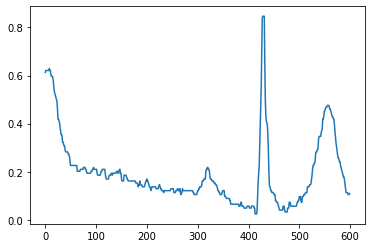

In [33]:
plt.plot(dataset[1][0])

## Training and Validation Split

In [34]:
batch_size = 64

# Split the dataset into train and validation sets
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

######################################################################################################################
############################        BATCH SIZE DECLARATION        ####################################################
######################################################################################################################

# Create data loaders for the train and validation sets
train_loader = DataLoader(train_dataset, num_workers=8, batch_size=batch_size, shuffle=False, pin_memory=True)
val_loader = DataLoader(val_dataset, num_workers=16, batch_size=batch_size, shuffle=False, pin_memory=True)

In [35]:
print(len(train_loader.dataset), len(val_loader.dataset))

3447 862


In [36]:
patients_id = common_ecg_names[:4309]

ids = []

for string in patients_id:
    start_index = string.find('/', string.find('/', string.find('/', string.find('/') + 1) + 1) + 1) + 1
    end_index = string.find('/', start_index)
    result = string[start_index:end_index]
    ids.append(result)

In [37]:
print(ids[:5])

['1000195', '1000384', '1000500', '1000511', '1000771']


In [38]:
len(ids)

4309

In [39]:
for i, (ecg_signal, mri_image) in enumerate(train_loader):
    print(ids[i*batch_size])
    if (mri_image.shape[0] != batch_size):
        print(ids[i*batch_size])
        ids = ids[:i*batch_size]

1000195
1008935
1016243
1024111
1033513
1041433
1049693
1058285
1065407
1075046
1082449
1089956
1099629
1109859
1116390
1123185
1130977
1139153
1146870
1154984
1163451
1171933
1178335
1186176
1194029
1200440
1208655
1216447
1224517
1235227
1243998
1252251
1261389
1269462
1278296
1285919
1294704
1301198
1310010
1318323
1328192
1336680
1344942
1351446
1360571
1370596
1379110
1387234
1395057
1400775
1408057
1416064
1424654
1433732
1433732


In [40]:
len(ids)

3392

In [41]:
ids_df = pd.DataFrame(ids, columns=['feid'])

In [42]:
ids_df['feid'] = ids_df['feid'].astype(int)
# Merge the data using pd.merge
train_df = pd.merge(ids_df, df, on='feid', how='left')

train_df.tail()

,feid,sex,sex_coded,bmi,Acute MI,Ventr. Tachy.,LV fail.
3387,1433118,Male,0.0,26.2346,0.0,0.0,0.0
3388,1433141,Female,1.0,26.0062,0.0,0.0,0.0
3389,1433278,Male,0.0,27.0853,0.0,0.0,0.0
3390,1433508,Male,0.0,21.8522,0.0,0.0,0.0
3391,1433672,Male,0.0,25.7619,0.0,0.0,0.0


In [43]:
train_df.shape

(3392, 7)

## Models Architecture

In our Implementation we created <b>3 AutoEncoder models</b> as shown in the above list:

- I) Fully Connected (Dense) Autoencoder for ECG's
- II) 2D Convolutional Autoencoder for MRI's
- III) Multi-modality autoencoder

The models I) and III) were presented in the notebooks ECG_Autoencoder and MRI_Autoencoder accordingly. The combined III) model will be explained in this notebook.

In [60]:
torch.cuda.empty_cache()

## Training for both ECG's and MRI's as pair modalities

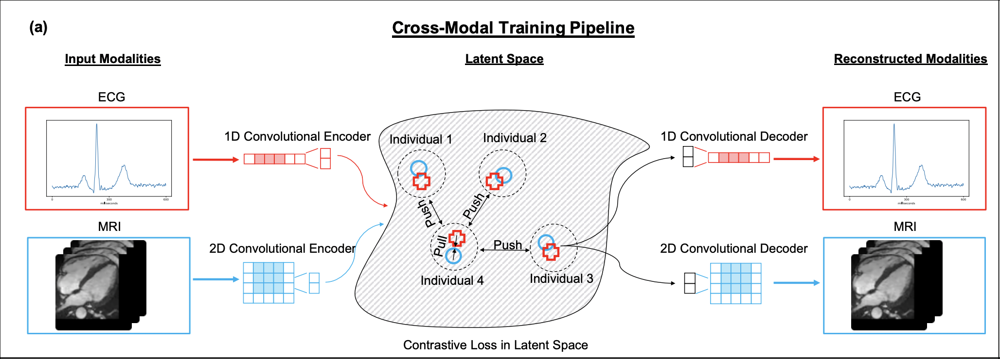

### I) Load pretrained Fully Connected (Dense) Autoencoder for ECG's

In [61]:
class EcgAutoencoder(nn.Module):
    def __init__(self):
        super(EcgAutoencoder, self).__init__()
        
        self.encoder = nn.Sequential(
            nn.Linear(600, 512),# nn.Linear(600, 256),
            nn.ReLU(),
            nn.Linear(512, 400),# nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(400, 300),# nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(300, 256),# nn.Linear(64, 32),
            nn.ReLU()
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(256, 300),# nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(300, 400),# nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(400, 512),# nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(512, 600),# nn.Linear(256, 600),
            nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

In [62]:
#########################################################################
###############      Load pretrained ECG autoencoder      ###############
#########################################################################

# Instantiate first
ecg_autoencoder = EcgAutoencoder()
# Load the weights of the pre-trained model
ecg_autoencoder.load_state_dict(torch.load('models/ecg_model_weights.pth'))
ecg_autoencoder.eval()

EcgAutoencoder(
  (encoder): Sequential(
    (0): Linear(in_features=600, out_features=512, bias=True)
    (1): ReLU()
    (2): Linear(in_features=512, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=300, bias=True)
    (5): ReLU()
    (6): Linear(in_features=300, out_features=256, bias=True)
    (7): ReLU()
  )
  (decoder): Sequential(
    (0): Linear(in_features=256, out_features=300, bias=True)
    (1): ReLU()
    (2): Linear(in_features=300, out_features=400, bias=True)
    (3): ReLU()
    (4): Linear(in_features=400, out_features=512, bias=True)
    (5): ReLU()
    (6): Linear(in_features=512, out_features=600, bias=True)
    (7): Sigmoid()
  )
)

### II) Load pretrained 2D Convolutional Autoencoder for MRI's

In [63]:
class DoubleConv(nn.Module):
    '''
    |------|    |------|    |------|    |------|    |------|    |------|
    | Conv | => | [BN] | => | ReLU | => | Conv | => | [BN] | => | ReLU |
    |------|    |------|    |------|    |------|    |------|    |------|
    '''
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            # One
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            # Two
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)
    
class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            # Use the previous block
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)
    
class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        # if bilinear, use the normal convolutions to reduce the number of channels
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1):
        x1 = self.up(x1)
        return self.conv(x1)
    
    
class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

In [64]:
class Encoder(nn.Module):
    def __init__(self, n_channels, bilinear=True):
        super(Encoder, self).__init__()
        self.n_channels = n_channels
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64) #DoubleConv(Input channel, output channel)
        
        self.down1 = Down(64, 128) # Down(Input channel, output channel)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 256)  # reduce spatial resolution and channels
        
        self.max = nn.MaxPool2d(kernel_size=16)
        self.avg = nn.AvgPool2d(kernel_size=16)
        self.dropout = nn.Dropout2d(p=0.2)
        
        self.down4 = Down(256, 256)  
        self.down5 = Down(256, 256)  
        self.down6 = Down(256, 256)  
        self.down7 = Down(256, 256)

    def forward(self, x):
        
        ## DownSampling in order from 128x128 --> 64x64 --> 32x32 --> 16x16 --> 1x1
        
        x1 = self.inc(x)# x1: 64 channels and 128x128
        x2 = self.down1(x1)# x2: 128 channels and 64x64
        x3 = self.down2(x2)# x3: 256 channels and 32x32
        x4 = self.down3(x3)# x4: 256 channels and 16x16
        
        # Using MaxPooling to reduce the spatial dimensions from 16x16 to 1x1 by keeping the Max Value
        x5 = self.max(x4)
        
        return x5

        

class Decoder(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(Decoder, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear
        

        ## UpSampling in order from 1x1 --> 2x2 --> 4x4 --> 8x8 --> 16x16 --> 32x32 --> 64x64 --> 128x128
        
        ## Up(input channel, output channel)
        self.up1 = Up(256, 256)
        self.up2 = Up(256, 256)
        self.up3 = Up(256, 256)
        self.up4 = Up(256, 256)
        self.up5 = Up(256, 256)
        
        self.up6 = Up(256, 128)
        self.up7 = Up(128, 64)
        
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        
        x = self.up1(x) # 1x1
        x = self.up2(x) # 2x2
        x = self.up3(x) # 4x4
        x = self.up4(x) # 8x8
        x = self.up5(x) # 16x16
        x = self.up6(x) # 32x32
        x = self.up7(x) # 64x64
        logits = self.outc(x) # 128x128

        return logits


    
class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(UNet, self).__init__()
        self.encoder = Encoder(n_channels, bilinear)
        self.decoder = Decoder(64, n_classes, bilinear)

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)

        return x

In [65]:
class MriAutoencoder(torch.nn.Module):
    def __init__(self):
        super().__init__()
        
        ##############    2D Convolutional Autoencoder for the MRI's.   ##############
        # Building a UNet-based Convolutional encoder-decoder for MRI input
        self.mri_encoder = Encoder(1, bilinear=True)
        self.mri_decoder = Decoder(512 // 2, 1, bilinear=True)


    def forward(self, mri_image):
        #print("MRI encoder input: ", mri_image.shape)
        mri_encoded = self.mri_encoder(mri_image)
        
        #print("MRI encoder output: ", mri_encoded.shape)
        decoded_mri = self.mri_decoder(mri_encoded)

        return decoded_mri

In [66]:
#########################################################################
###############      Load pretrained MRI autoencoder      ###############
#########################################################################

# Instantiate first
mri_autoencoder = MriAutoencoder()
# Load the weights of the pre-trained model
mri_autoencoder.load_state_dict(torch.load('models/mri_model_weights.pth'))
mri_autoencoder.eval()

MriAutoencoder(
  (mri_encoder): Encoder(
    (inc): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
    (down1): Down(
      (maxpool_conv): Sequential(
        (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        (1): DoubleConv(
          (double_conv): Sequential(
            (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace=True)
            (3): Conv2d(128, 128, kernel_size=(3, 3), stride

### III) Multi-modality autoencoder

In [67]:
class Ecg_Mri_Autoencoder(torch.nn.Module):
    def __init__(self):
        super().__init__()

        ##############    Fully Connected Autoencoder for the ECG's.   ##############
        self.ecg_encoder = ecg_autoencoder.encoder
        self.ecg_decoder = ecg_autoencoder.decoder
        
        ##############    2D Convolutional Autoencoder for the MRI's.   ##############
        # Building a UNet-based Convolutional encoder-decoder for MRI input
        self.mri_encoder = mri_autoencoder.mri_encoder
        self.mri_decoder = mri_autoencoder.mri_decoder



    def forward(self, ecg_signal, mri_image):
        ecg_encoded = self.ecg_encoder(ecg_signal)
        mri_encoded = self.mri_encoder(mri_image)

        decoded_ecg = self.ecg_decoder(ecg_encoded)
        decoded_mri = self.mri_decoder(mri_encoded)

        return ecg_encoded, mri_encoded, decoded_ecg, decoded_mri


### Instantiation of the Model

In [68]:
model = Ecg_Mri_Autoencoder().to(device)
loss_function = torch.nn.L1Loss()
optimizer = torch.optim.AdamW(model.parameters(),lr = 1e-3)

### Model Number of Parameters 

In [69]:
# model = Ecg_Mri_Autoencoder()  # Replace with your model

# total_params = 0

# for name, param in model.named_parameters():
#     if param.requires_grad:
#         num_params = param.numel()
#         total_params += num_params
#         print(f"Layer: {name}, Number of parameters: {num_params}")

# print(f"Total number of parameters for the model: {total_params}")


In [70]:
ecg_encoder_params = sum(p.numel() for p in model.ecg_encoder.parameters() if p.requires_grad)
ecg_decoder_params = sum(p.numel() for p in model.ecg_decoder.parameters() if p.requires_grad)
mri_encoder_params = sum(p.numel() for p in model.mri_encoder.parameters() if p.requires_grad)
mri_decoder_params = sum(p.numel() for p in model.mri_decoder.parameters() if p.requires_grad)

print("Number of parameters in the ECG Encoder:", ecg_encoder_params)
print("Number of parameters in the ECG Decoder:", ecg_decoder_params)
print("Number of parameters in the MRI Encoder:", mri_encoder_params)
print("Number of parameters in the MRI Decoder:", mri_decoder_params)

print("------------------------------------------------")

num_layers = len(list(model.modules())) - 1  # Subtract 1 to exclude the root module
print("Number of layers in the model:", num_layers)

print("")

pytorch_total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters for my model: ", pytorch_total_params)

Number of parameters in the ECG Encoder: 710268
Number of parameters in the ECG Decoder: 710612
Number of parameters in the MRI Encoder: 7051968
Number of parameters in the MRI Decoder: 3509057
------------------------------------------------
Number of layers in the model: 180

Total number of parameters for my model:  11981905


## Training

The training loss, L for cross-modal autoencoders is given as the linear combination of the following
two losses: (1) a reconstruction loss, LRec, which is used to reconstruct the original modalities; and
(2) a representation loss LContrastive, which is used to ensure that the representations for modalities
corresponding to the same sample are embedded nearby in the latent space. Formally, we have:

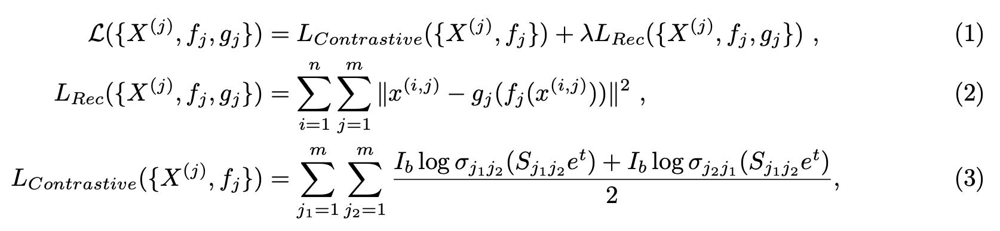

In [71]:
class ContrastiveLoss(nn.Module):
    def __init__(self, margin):
        super().__init__()
        self.margin = margin

    def forward(self, output1, output2, targets):
        
        repr1 = output1
        repr2 = output2.squeeze()
        
        repr1_norm = F.normalize(repr1, dim=1)
        repr2_norm = F.normalize(repr2, dim=1)

        similarity = torch.cosine_similarity(repr1_norm, repr2_norm, dim=1)
        distance = 1 - similarity
        
        targets = targets.to(device)

        loss = torch.mean(0.5 * targets.float() * distance.pow(2) +
                          0.5 * (1 - targets.float()) * F.relu(self.margin - distance).pow(2))
        
        return loss, distance

In [72]:
def compute_loss(rec_ecg, rec_mri, ecg, mri, encoded_ecg_repr, encoded_mri_repr, lamda_rec=1, lamda=0.1, temperature=0.5):
    
    contrastive_loss = ContrastiveLoss(margin=0.5)
    
    # Compute the reconstruction loss
    loss_rec = lamda_rec * F.l1_loss(rec_ecg, ecg) + F.l1_loss(rec_mri, mri)
    
    #print("Reconstruction Loss: ", loss_rec.item())
    
    # Compute the Contrastive loss using the ContrastiveLoss object
    loss_contrastive1, distance1 = contrastive_loss(encoded_ecg_repr, encoded_mri_repr, targets=torch.ones(encoded_ecg_repr.size(0)))
    
    encoded_mri_repr_inverted = torch.flip(encoded_mri_repr, [0])
    
    loss_contrastive2, distance2 = contrastive_loss(encoded_ecg_repr, encoded_mri_repr_inverted, targets=torch.zeros(encoded_ecg_repr.size(0)))
    
    
    loss_contrastive = loss_contrastive1 + loss_contrastive2
    
    #print("Contrastive Loss: ", loss_contrastive.item())
    
    # Compute the final loss as a linear combination of the two losses
    loss = lamda * loss_rec + (1 - lamda) * loss_contrastive
    
    return loss

In [177]:
epochs = 1 #15 #30 !
outputs = []
val_outputs = []
ecg_losses = []
mri_losses = []
losses = []
val_ecg_losses = []
val_mri_losses = []
val_losses = []

encoded_ecgs = []
encoded_mris = []

test_encoded_ecgs = []
test_encoded_mris = []

model.train()

print("Starting the Loop...","\n")

for epoch in range(epochs):
    
    ##################################################################################################################
    ###########################                  TRAINING                 ############################################
    ##################################################################################################################
    
    #model.train()
    
    print(f"Epoch {epoch+1}\n-------------------------------")
    
    print("-------    Training     -------","\n")
    for i, (ecg_signal, mri_image) in enumerate(train_loader):
        
        #print(ecg_signal.shape, mri_image.shape)
        
        if (mri_image.shape[0] == batch_size):
            
            
            # Send the training data to the GPU
            ecg_signal, mri_image = ecg_signal.to(device) , mri_image.to(device)

            # Output of CustomModel (Dont have to pass the reconstructed items to the GPU)
            encoded_ecg, encoded_mri, reconstructed_ecg, reconstructed_mri = model(ecg_signal, mri_image)

            # Calculating the loss function
            loss_ecg = loss_function(reconstructed_ecg, ecg_signal)
            loss_mri = loss_function(reconstructed_mri, mri_image)
            loss = compute_loss(reconstructed_ecg, reconstructed_mri, ecg_signal, mri_image, encoded_ecg, encoded_mri, lamda_rec=1, lamda=0.1, temperature=0.5)

            # The gradients are set to zero, the gradient is computed and stored and .step() performs parameter update
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Storing the losses in a list for plotting
            print("Training Loss: ", loss.item())
            #print("Training ECG Loss: ", loss_ecg.item(),"Training MRI Loss: ", loss_mri.item())
            ecg_losses.append(loss_ecg.item())
            mri_losses.append(loss_mri.item())
            losses.append(loss.item())
            outputs.append((epochs, ecg_signal, mri_image, reconstructed_ecg, reconstructed_mri))
            
            
            # Delete the tensors to free up GPU memory
            del ecg_signal, mri_image, reconstructed_ecg, reconstructed_mri, loss_ecg, loss_mri, loss #encoded_ecg, encoded_mri

            # Empty the GPU cache to release memory
            torch.cuda.empty_cache()
            
            #break
            
            # Save encoded ECG's and MRI's for the latent space visualisation
            if (epoch == epochs - 1):
                encoded_ecgs.append(encoded_ecg)
                encoded_mris.append(encoded_mri)
                        
                
                
        

    ##################################################################################################################
    ###########################                 VALIDATION                ############################################
    ##################################################################################################################
    
#     model.eval()
    
#     print("")
#     print("-------    Validation    -------","\n")
#     for i, (ecg_signal, mri_image) in enumerate(val_loader):
        
#         if (mri_image.shape[0] == batch_size):
        
#             # Send the training data to the GPU
#             ecg_signal, mri_image = ecg_signal.to(device) , mri_image.to(device)

#             # Output of CustomModel (Dont have to pass the reconstructed items to the GPU)
#             encoded_ecg, encoded_mri, reconstructed_ecg, reconstructed_mri = model(ecg_signal, mri_image)

#             # Calculating the loss function
#             val_loss_ecg = loss_function(reconstructed_ecg, ecg_signal)
#             val_loss_mri = loss_function(reconstructed_mri, mri_image)
#             val_loss = compute_loss(reconstructed_ecg, reconstructed_mri, ecg_signal, mri_image, encoded_ecg, encoded_mri, lamda_rec=1, lamda=0.1, temperature=0.5)


#             # Storing the losses in a list for plotting
#             print("Validation Loss: ", val_loss.item())
#             #print("Validation ECG Loss: ", val_loss_ecg.item(),"Validation MRI Loss: ", val_loss_mri.item())
#             val_ecg_losses.append(val_loss_ecg.item())
#             val_mri_losses.append(val_loss_mri.item())
#             val_losses.append(val_loss.item())
#             val_outputs.append((epochs, ecg_signal, mri_image, reconstructed_ecg, reconstructed_mri))
            
#             # Delete the tensors to free up GPU memory
#             del ecg_signal, mri_image, encoded_ecg, encoded_mri, reconstructed_ecg, reconstructed_mri#, val_loss_ecg, val_loss_mri, val_loss

#             # Empty the GPU cache to release memory
#             torch.cuda.empty_cache()
        
    #break
    
    print("")
    
print("")
print("Done!")

Starting the Loop... 

Epoch 1
-------------------------------
-------    Training     ------- 

Training Loss:  3.4144058227539062
Training Loss:  3.5462138652801514
Training Loss:  3.421628952026367
Training Loss:  3.302640914916992
Training Loss:  3.659635066986084
Training Loss:  3.3334836959838867
Training Loss:  3.351447343826294
Training Loss:  3.51664400100708
Training Loss:  3.461491823196411
Training Loss:  3.424417734146118
Training Loss:  3.537196397781372
Training Loss:  3.332764148712158
Training Loss:  3.3294334411621094
Training Loss:  3.2861666679382324
Training Loss:  3.5373952388763428
Training Loss:  3.4112308025360107
Training Loss:  3.330533504486084
Training Loss:  3.4210944175720215
Training Loss:  3.4702634811401367
Training Loss:  3.4890005588531494
Training Loss:  3.4210662841796875
Training Loss:  3.411855936050415
Training Loss:  3.4562132358551025
Training Loss:  3.3338005542755127
Training Loss:  3.372382164001465
Training Loss:  3.471235513687134
Trainin

### Visualise the Latent Space - Plot the T-SNE for all the subjects on the last epoch

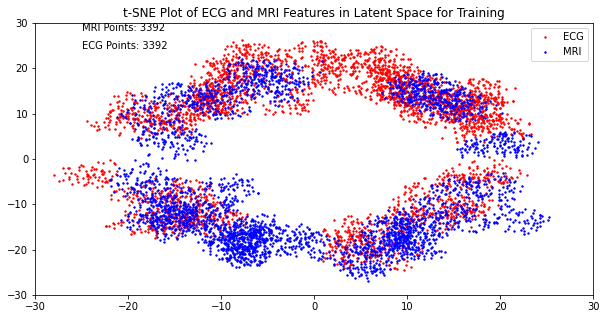

In [190]:
ecg_results = []
mri_results = []

for ecg, mri in zip(encoded_ecgs, encoded_mris):
    mri = mri.squeeze().squeeze()

    # Convert the lists of tensors into NumPy arrays
    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    # Perform t-SNE on the combined features
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    # Separate the t-SNE results for ecgs and mris
    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    ecg_results.append(ecg_tsne)
    mri_results.append(mri_tsne)

# Concatenate the results
ecg_results = np.concatenate(ecg_results, axis=0)
mri_results = np.concatenate(mri_results, axis=0)

# Count the number of points plotted
ecg_points = len(ecg_results)
mri_points = len(mri_results)

# Plot the t-SNE results
plt.figure(figsize=(10, 5))
plt.scatter(ecg_results[:, 0], ecg_results[:, 1], color='red', label='ECG', s=2)
plt.scatter(mri_results[:, 0], mri_results[:, 1], color='blue', label='MRI', s=2)
plt.title('t-SNE Plot of ECG and MRI Features in Latent Space for Training')
plt.xlim(-30, 30)
plt.ylim(-30, 30)
plt.legend()

# Print the point count
plt.text(-25, 26, f"ECG Points: {ecg_points}", ha='left', va='top')
plt.text(-25, 28, f"MRI Points: {mri_points}", ha='left', va='top')

plt.show()

### T-SNE Visualisation based on Sex

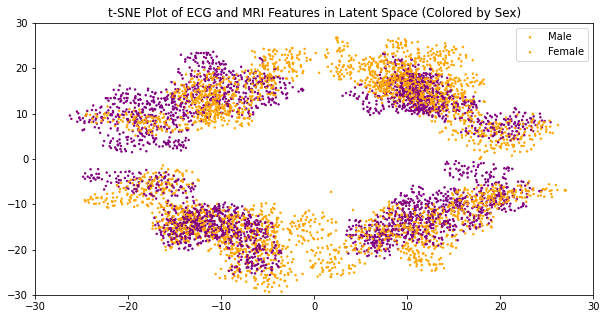

In [77]:
ecg_results = []
mri_results = []
sex_labels = []

# Encode sex labels as numeric values
#le = LabelEncoder()
#train_df['sex_encoded'] = le.fit_transform(train_df['sex'])

for ecg, mri, sex in zip(encoded_ecgs, encoded_mris, train_df['sex_coded']):
    mri = mri.squeeze().squeeze()

    # Convert the lists of tensors into NumPy arrays
    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    # Perform t-SNE on the combined features
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    # Separate the t-SNE results for ecgs and mris
    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    ecg_results.append(ecg_tsne)
    mri_results.append(mri_tsne)
    sex_labels.extend([sex] * len(ecg))  # Add sex label for each patient

# Concatenate the results
ecg_results = np.concatenate(ecg_results, axis=0)
mri_results = np.concatenate(mri_results, axis=0)

# Define colors for men and women
colors = ['purple', 'orange']

# Plot the t-SNE results with sex-based coloring
plt.figure(figsize=(10, 5))
plt.scatter(ecg_results[:, 0], ecg_results[:, 1], c=[colors[int(label)] for label in sex_labels], label='Male', s=2)
plt.scatter(mri_results[:, 0], mri_results[:, 1], c=[colors[int(label)] for label in sex_labels], label='Female', s=2)
plt.title('t-SNE Plot of ECG and MRI Features in Latent Space (Colored by Sex)')
plt.xlim(-30, 30)
plt.ylim(-30, 30)
plt.legend()
plt.show()

In [78]:
ecg_results = []
mri_results = []
sex_labels = []

# Encode sex labels as numeric values
#le = LabelEncoder()
#train_df['sex_encoded'] = le.fit_transform(train_df['sex'])

for ecg, mri, sex in zip(encoded_ecgs, encoded_mris, train_df['sex_coded']):
    mri = mri.squeeze().squeeze()

    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    ecg_results.append(ecg_tsne)
    mri_results.append(mri_tsne)
    sex_labels.extend([(sex, 'ECG')] * len(ecg))
    sex_labels.extend([(sex, 'MRI')] * len(mri))

ecg_results = np.concatenate(ecg_results, axis=0)
mri_results = np.concatenate(mri_results, axis=0)

def get_color(label, modality):
    color_map = {
        (0, 'ECG'): 'red',
        (1, 'ECG'): 'green',
        (0, 'MRI'): 'blue',
        (1, 'MRI'): 'yellow',
    }
    return color_map[(label, modality)]

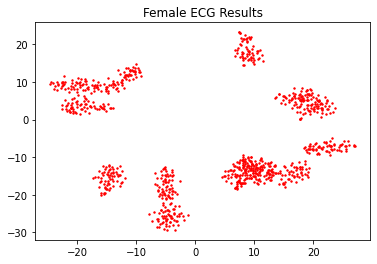

In [79]:
female_ecg_results = []
for result, (sex, modality) in zip(ecg_results, sex_labels):
    if sex == 1 and modality == 'ECG': 
        female_ecg_results.append(result)

female_ecg_results = np.array(female_ecg_results)

# Plot the Female ECG results
plt.scatter(female_ecg_results[:, 0], female_ecg_results[:, 1], c='red', s=2)
plt.title("Female ECG Results")
plt.show()

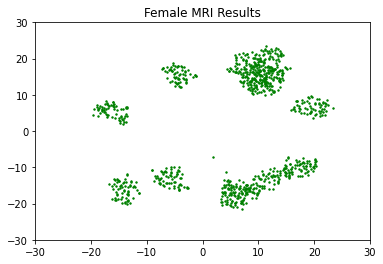

In [80]:
female_mri_results = []
for result, (sex, modality) in zip(mri_results, sex_labels):
    if sex == 1 and modality == 'MRI': 
        female_mri_results.append(result)

female_mri_results = np.array(female_mri_results)

# Plot the Female MRI results
plt.scatter(female_mri_results[:, 0], female_mri_results[:, 1], c='green', s=2)
plt.title("Female MRI Results")
plt.xlim(-30, 30)
plt.ylim(-30, 30)
plt.show()

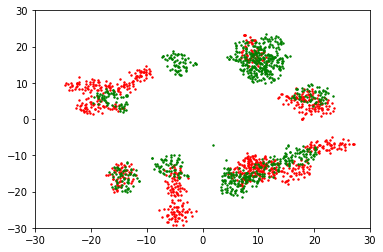

In [81]:
plt.scatter(female_ecg_results[:, 0], female_ecg_results[:, 1], c='red', s=2)
plt.scatter(female_mri_results[:, 0], female_mri_results[:, 1], c='green', s=2)
plt.xlim(-30, 30)
plt.ylim(-30, 30)
plt.show()

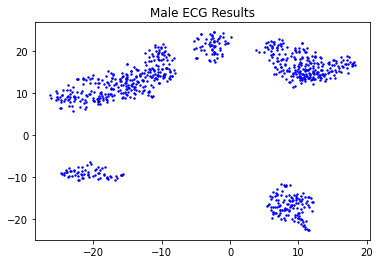

In [82]:
male_ecg_results = []
for result, (sex, modality) in zip(ecg_results, sex_labels):
    if sex == 0 and modality == 'ECG': 
        male_ecg_results.append(result)

male_ecg_results = np.array(male_ecg_results)

# Plot the Male ECG results
plt.scatter(male_ecg_results[:, 0], male_ecg_results[:, 1], c='blue', s=2)
plt.title("Male ECG Results")
plt.show()

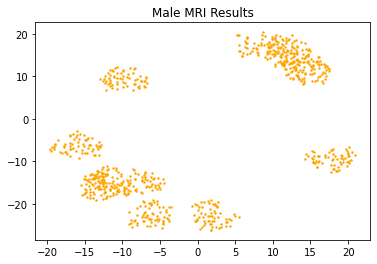

In [83]:
male_mri_results = []
for result, (sex, modality) in zip(mri_results, sex_labels):
    if sex == 0 and modality == 'MRI': 
        male_mri_results.append(result)

male_mri_results = np.array(male_mri_results)

# Plot the Male MRI results
plt.scatter(male_mri_results[:, 0], male_mri_results[:, 1], c='orange', s=2)
plt.title("Male MRI Results")
plt.show()

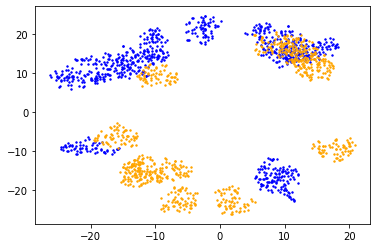

In [84]:
plt.scatter(male_ecg_results[:, 0], male_ecg_results[:, 1], c='blue', s=2)
plt.scatter(male_mri_results[:, 0], male_mri_results[:, 1], c='orange', s=2)
plt.show()

### T-SNE Visualisation based on Acute MI

In [231]:
for index, row in train_df.iterrows():
    if row['Acute MI'] == 1.0:
        print(f"Index: {index}, Acute MI: {row['Acute MI']}")

Index: 99, Acute MI: 1.0
Index: 586, Acute MI: 1.0
Index: 958, Acute MI: 1.0
Index: 1233, Acute MI: 1.0
Index: 1373, Acute MI: 1.0
Index: 1994, Acute MI: 1.0
Index: 2003, Acute MI: 1.0
Index: 2028, Acute MI: 1.0
Index: 2049, Acute MI: 1.0
Index: 2424, Acute MI: 1.0
Index: 2513, Acute MI: 1.0
Index: 2621, Acute MI: 1.0
Index: 2707, Acute MI: 1.0
Index: 2845, Acute MI: 1.0
Index: 3173, Acute MI: 1.0


In [286]:
ecg_results = []
mri_results = []
ecg_acute_mi_labels = []
mri_acute_mi_labels = []

for i, (ecg, mri) in enumerate(zip(encoded_ecgs, encoded_mris)):

    mri = mri.squeeze().squeeze()

    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    ecg_results.append(ecg_tsne)
    mri_results.append(mri_tsne)
    
    for j in range(batch_size):
        #print(j+i*batch_size)
        ecg_acute_mi_labels.extend([(train_df['Acute MI'][j+i*batch_size], 'ECG')])
        mri_acute_mi_labels.extend([(train_df['Acute MI'][j+i*batch_size], 'MRI')])

ecg_results = np.concatenate(ecg_results, axis=0)
mri_results = np.concatenate(mri_results, axis=0)

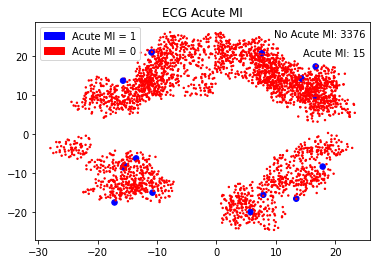

In [294]:
# Define the colors based on the acute_mi_labels
colors = ['blue' if label[0]==1 else 'red' for label in ecg_acute_mi_labels]

# Define the scatter sizes based on the acute_mi_labels
sizes = [30 if label[0] == 1 else 2 for label in ecg_acute_mi_labels]

# Plot the t-SNE results for ECG
plt.scatter(ecg_results[:, 0], ecg_results[:, 1], c=colors[:len(ecg_results)], s=sizes[:len(ecg_results)])

# Add legend
blue_patch = plt.Circle((0, 0), 0.1, color='blue', label='Acute MI = 1')
red_patch = plt.Circle((0, 0), 0.1, color='red', label='Acute MI = 0')
plt.legend(handles=[blue_patch, red_patch])
plt.title("ECG Acute MI")

# Count the number of points for each category
num_acute_mi = sum([label[0] == 1 for label in ecg_acute_mi_labels])
num_no_acute_mi = sum([label[0] == 0 for label in ecg_acute_mi_labels])

# Print the counts
plt.text(25, 25, f"No Acute MI: {num_no_acute_mi}", ha='right')
plt.text(25, 20, f"Acute MI: {num_acute_mi}", ha='right')

# Show the plot
plt.show()

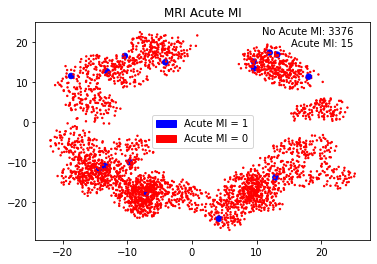

In [299]:
# Define the colors based on the acute_mi_labels
colors = ['blue' if label[0]==1 else 'red' for label in mri_acute_mi_labels]

# Define the scatter sizes based on the acute_mi_labels
sizes = [30 if label[0] == 1 else 2 for label in mri_acute_mi_labels]

# Plot the t-SNE results for MRI
plt.scatter(mri_results[:, 0], mri_results[:, 1], c=colors[:len(mri_results)], s=sizes[:len(mri_results)])

# Add legend
blue_patch = plt.Circle((0, 0), 0.1, color='blue', label='Acute MI = 1')
red_patch = plt.Circle((0, 0), 0.1, color='red', label='Acute MI = 0')
plt.legend(handles=[blue_patch, red_patch])
plt.title("MRI Acute MI")

# Count the number of points for each category
num_acute_mi = sum([label[0] == 1 for label in mri_acute_mi_labels])
num_no_acute_mi = sum([label[0] == 0 for label in mri_acute_mi_labels])

# Print the counts
plt.text(25, 22, f"No Acute MI: {num_no_acute_mi}", ha='right')
plt.text(25, 19, f"Acute MI: {num_acute_mi}", ha='right')

# Show the plot
plt.show()

### T-SNE Visualisation based on Ventr. Tachy.

In [301]:
for index, row in train_df.iterrows():
    if row['Ventr. Tachy.'] == 1.0:
        print(f"Index: {index}, Ventr. Tachy: {row['Ventr. Tachy.']}")

Index: 2711, Ventr. Tachy: 1.0
Index: 2922, Ventr. Tachy: 1.0


In [302]:
ecg_results = []
mri_results = []
ecg_ventr_labels = []
mri_ventr_labels = []

for i, (ecg, mri) in enumerate(zip(encoded_ecgs, encoded_mris)):

    mri = mri.squeeze().squeeze()

    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    ecg_results.append(ecg_tsne)
    mri_results.append(mri_tsne)
    
    for j in range(batch_size):
        #print(j+i*batch_size)
        ecg_ventr_labels.extend([(train_df['Ventr. Tachy.'][j+i*batch_size], 'ECG')])
        mri_ventr_labels.extend([(train_df['Ventr. Tachy.'][j+i*batch_size], 'MRI')])

ecg_results = np.concatenate(ecg_results, axis=0)
mri_results = np.concatenate(mri_results, axis=0)

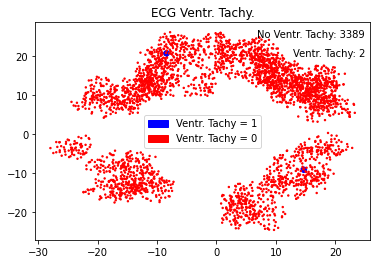

In [303]:
# Define the colors based on the ventr_labels
colors = ['blue' if label[0]==1 else 'red' for label in ecg_ventr_labels]

# Define the scatter sizes based on the ventr_labels
sizes = [30 if label[0] == 1 else 2 for label in ecg_ventr_labels]

# Plot the t-SNE results for ECG
plt.scatter(ecg_results[:, 0], ecg_results[:, 1], c=colors[:len(ecg_results)], s=sizes[:len(ecg_results)])

# Add legend
blue_patch = plt.Circle((0, 0), 0.1, color='blue', label='Ventr. Tachy = 1')
red_patch = plt.Circle((0, 0), 0.1, color='red', label='Ventr. Tachy = 0')
plt.legend(handles=[blue_patch, red_patch])
plt.title("ECG Ventr. Tachy.")

# Count the number of points for each category
num_ventr = sum([label[0] == 1 for label in ecg_ventr_labels])
num_no_ventr = sum([label[0] == 0 for label in ecg_ventr_labels])

# Print the counts
plt.text(25, 25, f"No Ventr. Tachy: {num_no_ventr}", ha='right')
plt.text(25, 20, f"Ventr. Tachy: {num_ventr}", ha='right')

# Show the plot
plt.show()

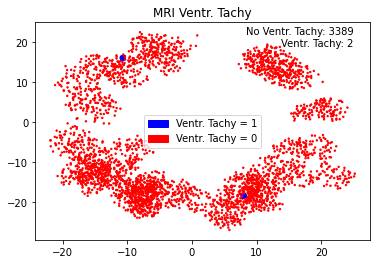

In [304]:
# Define the colors based on the ventr_labels
colors = ['blue' if label[0]==1 else 'red' for label in mri_ventr_labels]

# Define the scatter sizes based on the ventr_labels
sizes = [30 if label[0] == 1 else 2 for label in mri_ventr_labels]

# Plot the t-SNE results for MRI
plt.scatter(mri_results[:, 0], mri_results[:, 1], c=colors[:len(mri_results)], s=sizes[:len(mri_results)])

# Add legend
blue_patch = plt.Circle((0, 0), 0.1, color='blue', label='Ventr. Tachy = 1')
red_patch = plt.Circle((0, 0), 0.1, color='red', label='Ventr. Tachy = 0')
plt.legend(handles=[blue_patch, red_patch])
plt.title("MRI Ventr. Tachy")

# Count the number of points for each category
num_ventr = sum([label[0] == 1 for label in mri_ventr_labels])
num_no_ventr = sum([label[0] == 0 for label in mri_ventr_labels])

# Print the counts
plt.text(25, 22, f"No Ventr. Tachy: {num_no_ventr}", ha='right')
plt.text(25, 19, f"Ventr. Tachy: {num_ventr}", ha='right')

# Show the plot
plt.show()

### T-SNE Visualisation based on LV fail.

In [306]:
for index, row in train_df.iterrows():
    if row['LV fail.'] == 1.0:
        print(f"Index: {index}, LV fail: {row['LV fail.']}")

Index: 958, LV fail: 1.0
Index: 1412, LV fail: 1.0
Index: 2814, LV fail: 1.0
Index: 3222, LV fail: 1.0
Index: 3382, LV fail: 1.0


In [307]:
ecg_results = []
mri_results = []
ecg_lv_labels = []
mri_lv_labels = []

for i, (ecg, mri) in enumerate(zip(encoded_ecgs, encoded_mris)):

    mri = mri.squeeze().squeeze()

    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    ecg_results.append(ecg_tsne)
    mri_results.append(mri_tsne)
    
    for j in range(batch_size):
        #print(j+i*batch_size)
        ecg_lv_labels.extend([(train_df['LV fail.'][j+i*batch_size], 'ECG')])
        mri_lv_labels.extend([(train_df['LV fail.'][j+i*batch_size], 'MRI')])

ecg_results = np.concatenate(ecg_results, axis=0)
mri_results = np.concatenate(mri_results, axis=0)

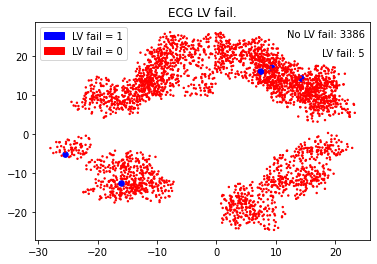

In [308]:
# Define the colors based on the lv_labels
colors = ['blue' if label[0]==1 else 'red' for label in ecg_lv_labels]

# Define the scatter sizes based on the lv_labels
sizes = [30 if label[0] == 1 else 2 for label in ecg_lv_labels]

# Plot the t-SNE results for ECG
plt.scatter(ecg_results[:, 0], ecg_results[:, 1], c=colors[:len(ecg_results)], s=sizes[:len(ecg_results)])

# Add legend
blue_patch = plt.Circle((0, 0), 0.1, color='blue', label='LV fail = 1')
red_patch = plt.Circle((0, 0), 0.1, color='red', label='LV fail = 0')
plt.legend(handles=[blue_patch, red_patch])
plt.title("ECG LV fail.")

# Count the number of points for each category
num_lv = sum([label[0] == 1 for label in ecg_lv_labels])
num_no_lv = sum([label[0] == 0 for label in ecg_lv_labels])

# Print the counts
plt.text(25, 25, f"No LV fail: {num_no_lv}", ha='right')
plt.text(25, 20, f"LV fail: {num_lv}", ha='right')

# Show the plot
plt.show()

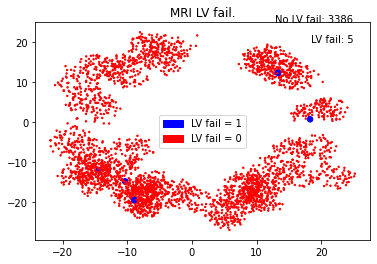

In [309]:
# Define the colors based on the lv_labels
colors = ['blue' if label[0]==1 else 'red' for label in mri_lv_labels]

# Define the scatter sizes based on the lv_labels
sizes = [30 if label[0] == 1 else 2 for label in mri_lv_labels]

# Plot the t-SNE results for MRI
plt.scatter(mri_results[:, 0], mri_results[:, 1], c=colors[:len(mri_results)], s=sizes[:len(mri_results)])

# Add legend
blue_patch = plt.Circle((0, 0), 0.1, color='blue', label='LV fail = 1')
red_patch = plt.Circle((0, 0), 0.1, color='red', label='LV fail = 0')
plt.legend(handles=[blue_patch, red_patch])
plt.title("MRI LV fail.")

# Count the number of points for each category
num_lv = sum([label[0] == 1 for label in mri_lv_labels])
num_no_lv = sum([label[0] == 0 for label in mri_lv_labels])

# Print the counts
plt.text(25, 25, f"No LV fail: {num_no_lv}", ha='right')
plt.text(25, 20, f"LV fail: {num_lv}", ha='right')

# Show the plot
plt.show()

## <center>Training Results</center>

### Total Loss

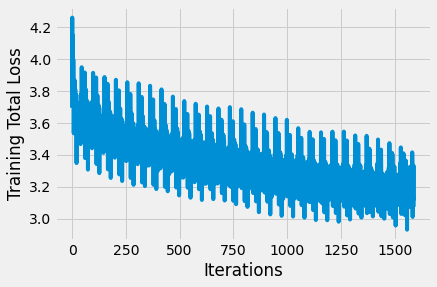

In [59]:
# Defining the Plot Style
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Training Total Loss')

# Plotting values
plt.plot(losses[-10000:])
plt.show()

### ECG Loss

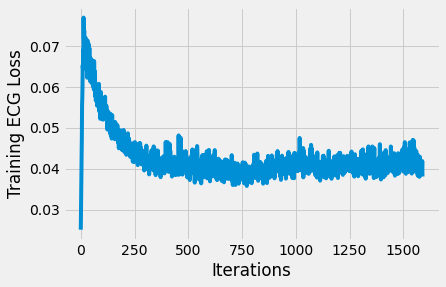

In [60]:
# Defining the Plot Style
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Training ECG Loss')

# Plotting values
plt.plot(ecg_losses[-10000:])
plt.show()

### MRI Loss

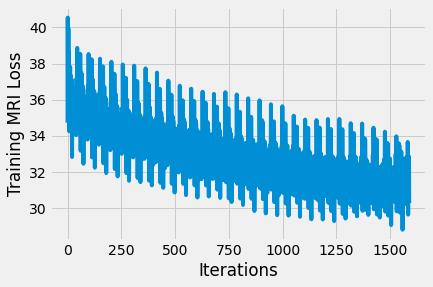

In [61]:
# Defining the Plot Style
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Training MRI Loss')

# Plotting values
plt.plot(mri_losses[-10000:])
plt.show()

### Plotting the Original and Reconstructed Image


-------------------    Plot of MRI/Reconstructed MRI:   0    -------------------



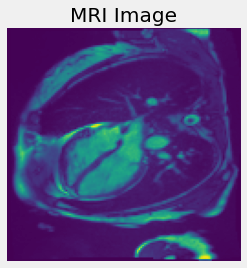

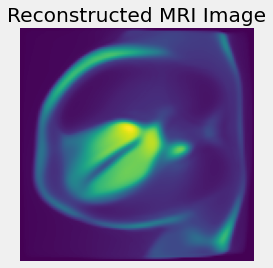


-------------------    Plot of MRI/Reconstructed MRI:   1    -------------------



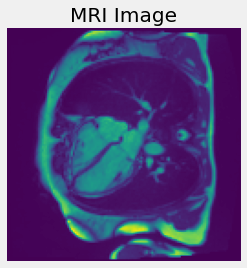

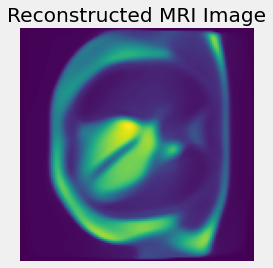


-------------------    Plot of MRI/Reconstructed MRI:   2    -------------------



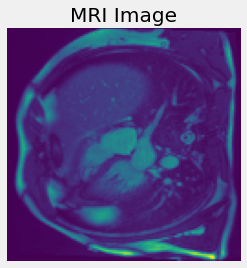

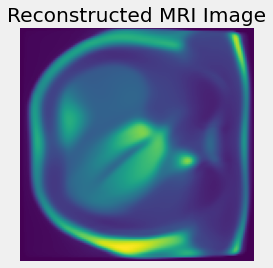


-------------------    Plot of MRI/Reconstructed MRI:   3    -------------------



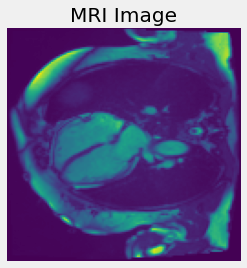

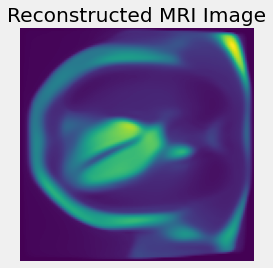


-------------------    Plot of MRI/Reconstructed MRI:   4    -------------------



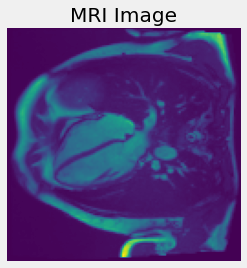

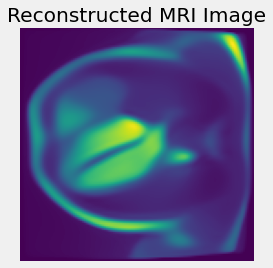


-------------------    Plot of MRI/Reconstructed MRI:   5    -------------------



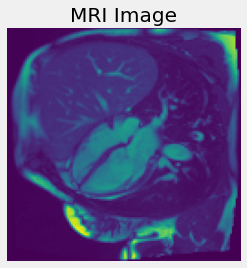

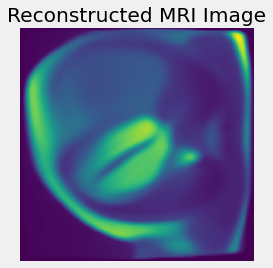


-------------------    Plot of MRI/Reconstructed MRI:   6    -------------------



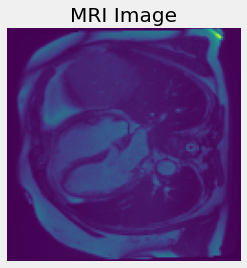

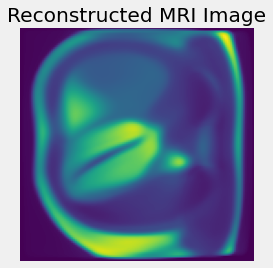


-------------------    Plot of MRI/Reconstructed MRI:   7    -------------------



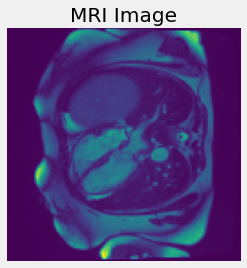

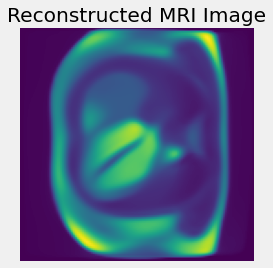


-------------------    Plot of MRI/Reconstructed MRI:   8    -------------------



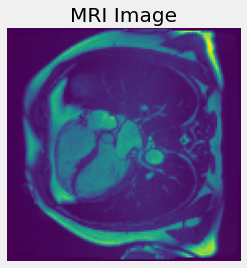

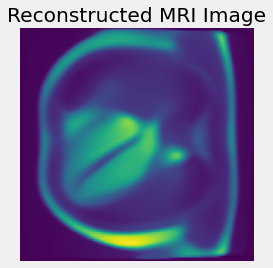


-------------------    Plot of MRI/Reconstructed MRI:   9    -------------------



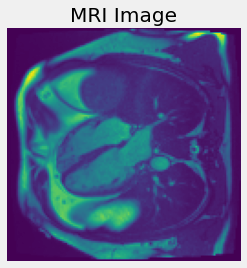

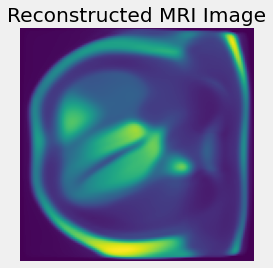


-------------------    Plot of MRI/Reconstructed MRI:   10    -------------------



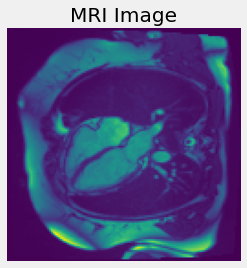

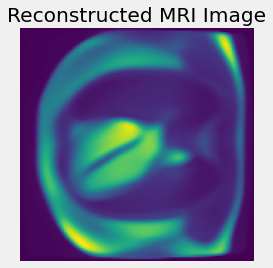


-------------------    Plot of MRI/Reconstructed MRI:   11    -------------------



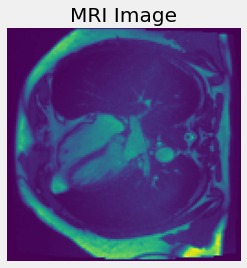

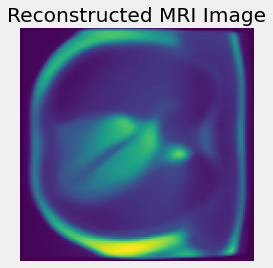


-------------------    Plot of MRI/Reconstructed MRI:   12    -------------------



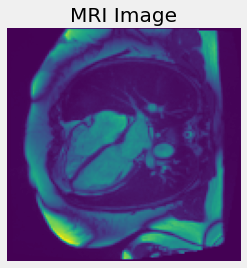

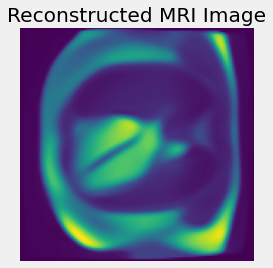


-------------------    Plot of MRI/Reconstructed MRI:   13    -------------------



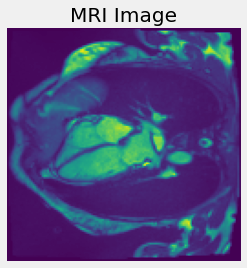

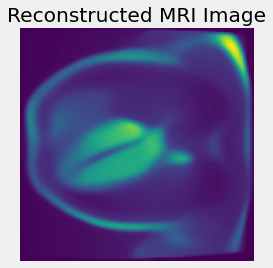


-------------------    Plot of MRI/Reconstructed MRI:   14    -------------------



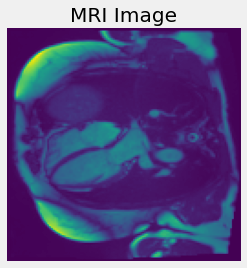

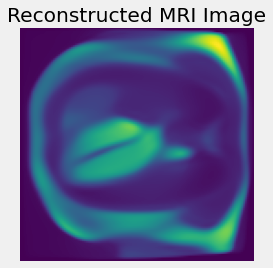


-------------------    Plot of MRI/Reconstructed MRI:   15    -------------------



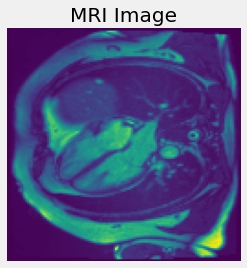

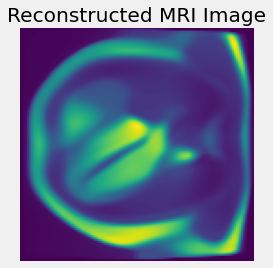


-------------------    Plot of MRI/Reconstructed MRI:   16    -------------------



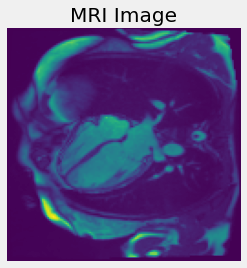

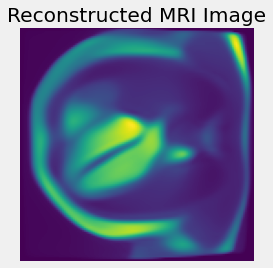


-------------------    Plot of MRI/Reconstructed MRI:   17    -------------------



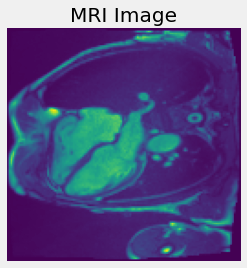

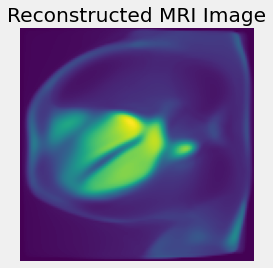


-------------------    Plot of MRI/Reconstructed MRI:   18    -------------------



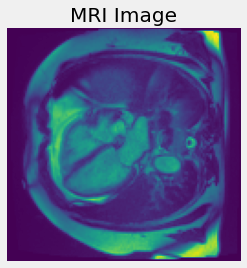

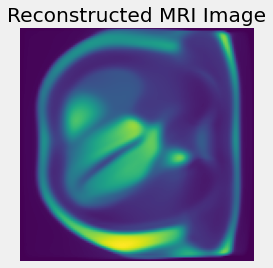


-------------------    Plot of MRI/Reconstructed MRI:   19    -------------------



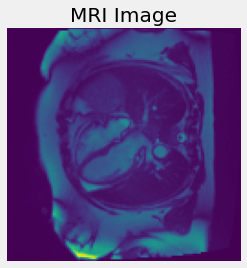

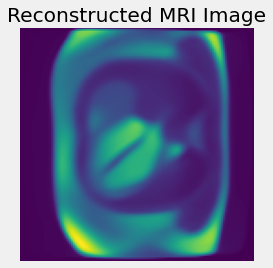


-------------------    Plot of MRI/Reconstructed MRI:   20    -------------------



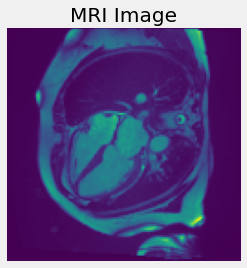

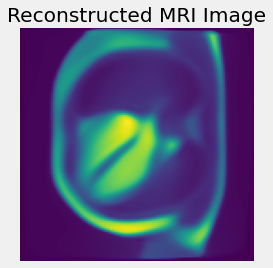


-------------------    Plot of MRI/Reconstructed MRI:   21    -------------------



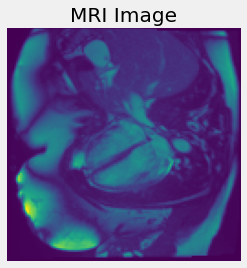

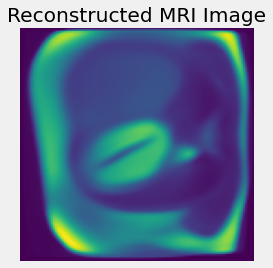


-------------------    Plot of MRI/Reconstructed MRI:   22    -------------------



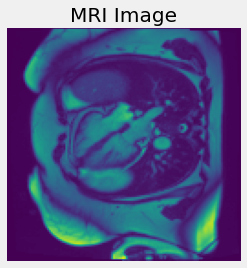

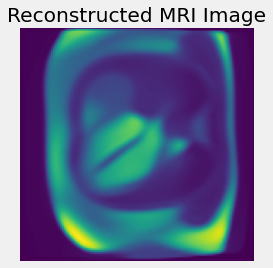


-------------------    Plot of MRI/Reconstructed MRI:   23    -------------------



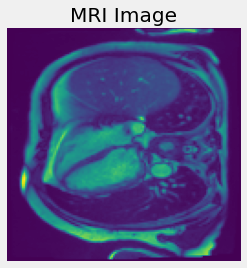

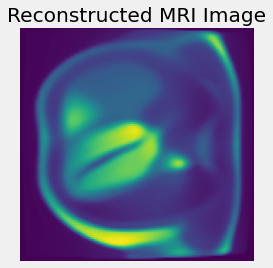


-------------------    Plot of MRI/Reconstructed MRI:   24    -------------------



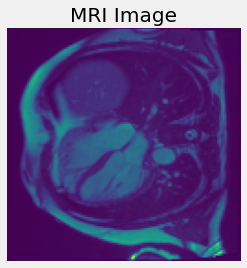

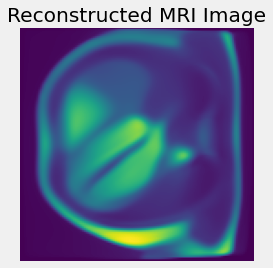


-------------------    Plot of MRI/Reconstructed MRI:   25    -------------------



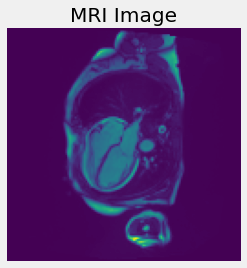

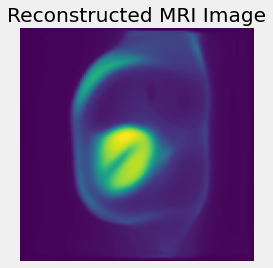


-------------------    Plot of MRI/Reconstructed MRI:   26    -------------------



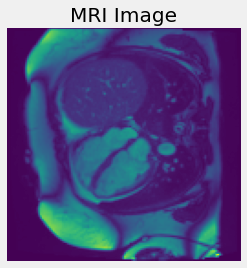

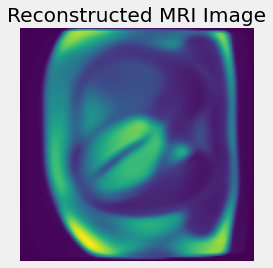


-------------------    Plot of MRI/Reconstructed MRI:   27    -------------------



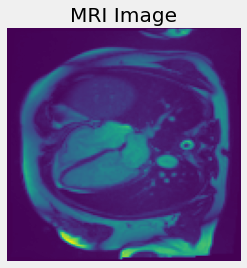

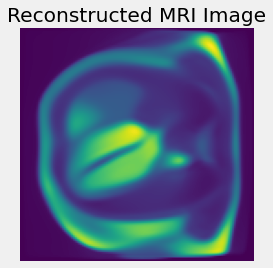


-------------------    Plot of MRI/Reconstructed MRI:   28    -------------------



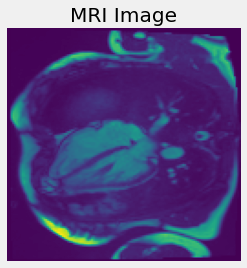

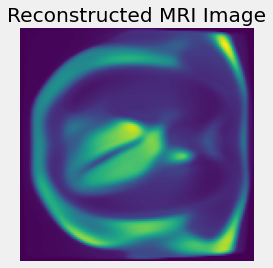


-------------------    Plot of MRI/Reconstructed MRI:   29    -------------------



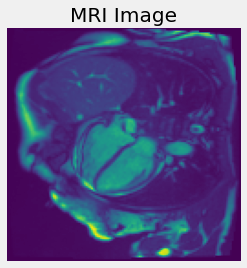

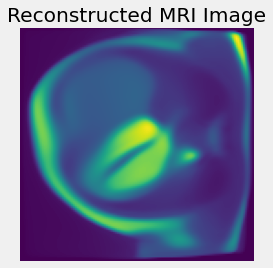


-------------------    Plot of MRI/Reconstructed MRI:   30    -------------------



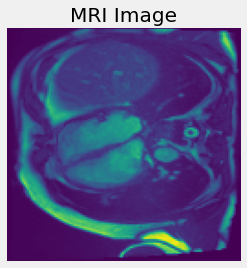

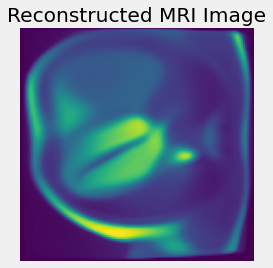


-------------------    Plot of MRI/Reconstructed MRI:   31    -------------------



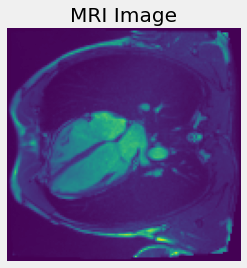

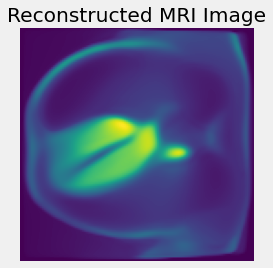


-------------------    Plot of MRI/Reconstructed MRI:   32    -------------------



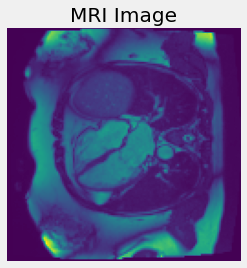

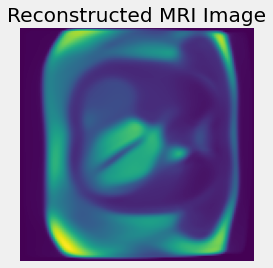


-------------------    Plot of MRI/Reconstructed MRI:   33    -------------------



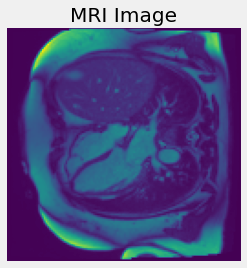

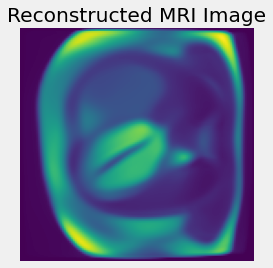


-------------------    Plot of MRI/Reconstructed MRI:   34    -------------------



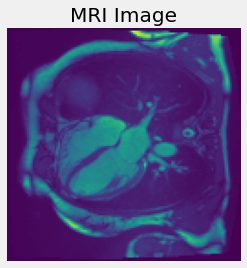

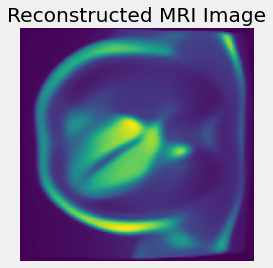


-------------------    Plot of MRI/Reconstructed MRI:   35    -------------------



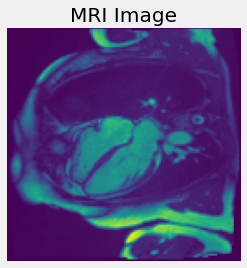

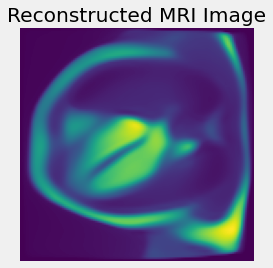


-------------------    Plot of MRI/Reconstructed MRI:   36    -------------------



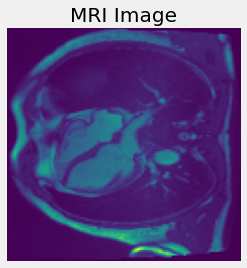

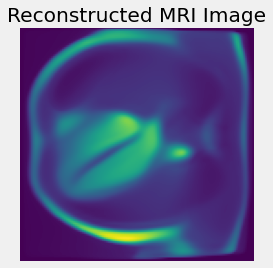


-------------------    Plot of MRI/Reconstructed MRI:   37    -------------------



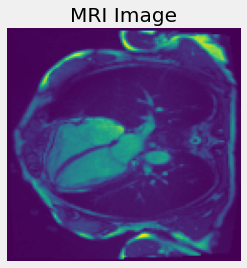

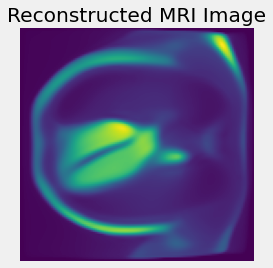


-------------------    Plot of MRI/Reconstructed MRI:   38    -------------------



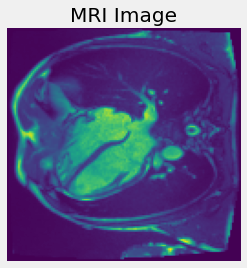

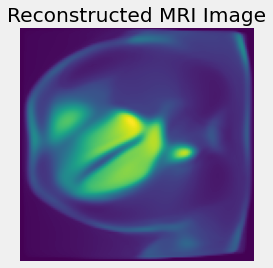


-------------------    Plot of MRI/Reconstructed MRI:   39    -------------------



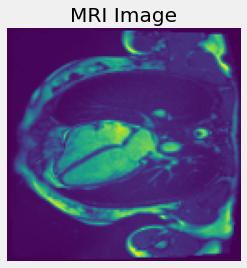

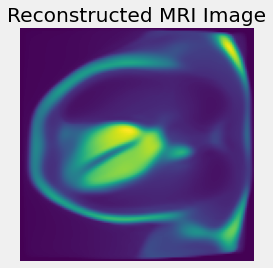


-------------------    Plot of MRI/Reconstructed MRI:   40    -------------------



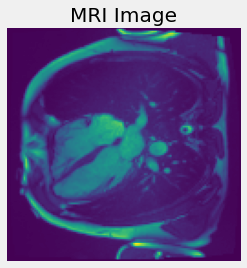

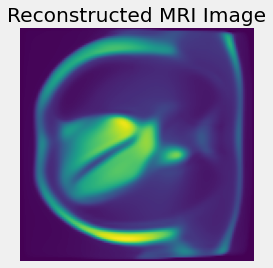


-------------------    Plot of MRI/Reconstructed MRI:   41    -------------------



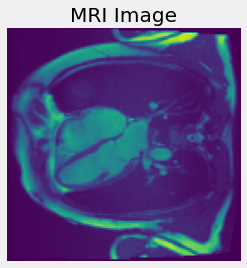

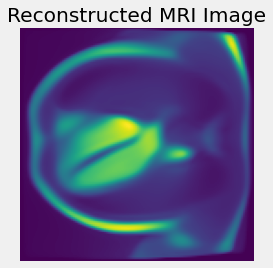


-------------------    Plot of MRI/Reconstructed MRI:   42    -------------------



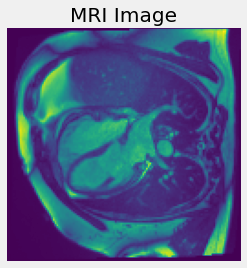

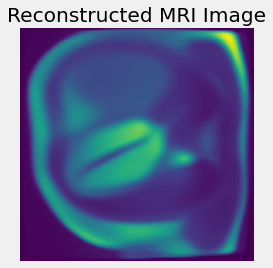


-------------------    Plot of MRI/Reconstructed MRI:   43    -------------------



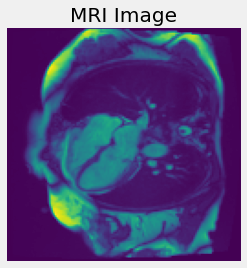

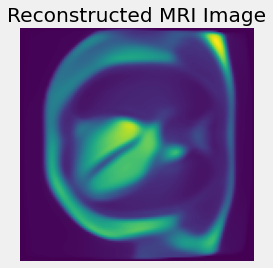


-------------------    Plot of MRI/Reconstructed MRI:   44    -------------------



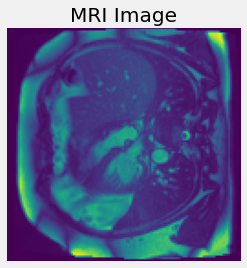

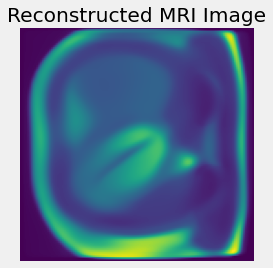


-------------------    Plot of MRI/Reconstructed MRI:   45    -------------------



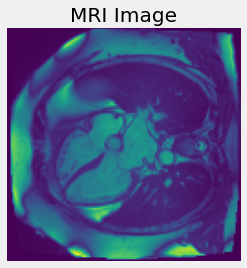

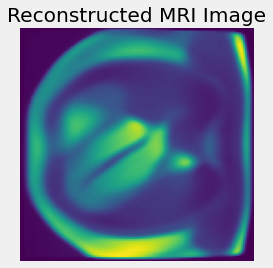


-------------------    Plot of MRI/Reconstructed MRI:   46    -------------------



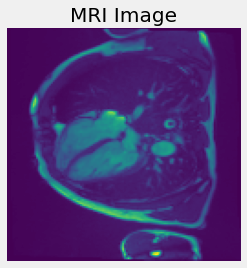

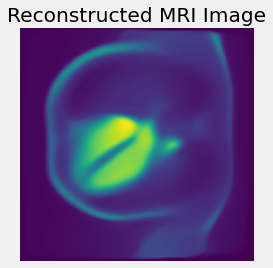


-------------------    Plot of MRI/Reconstructed MRI:   47    -------------------



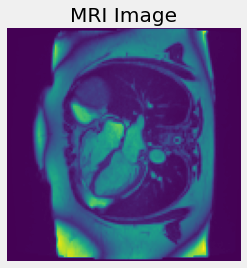

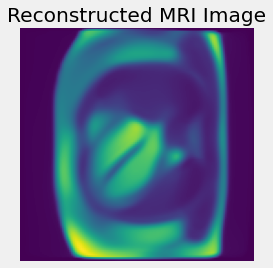


-------------------    Plot of MRI/Reconstructed MRI:   48    -------------------



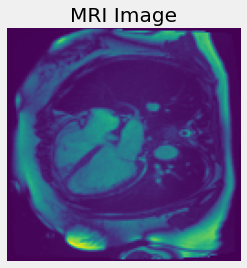

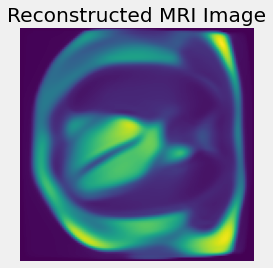


-------------------    Plot of MRI/Reconstructed MRI:   49    -------------------



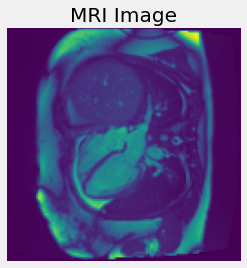

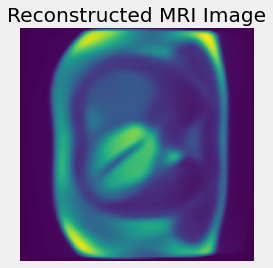


-------------------    Plot of MRI/Reconstructed MRI:   50    -------------------



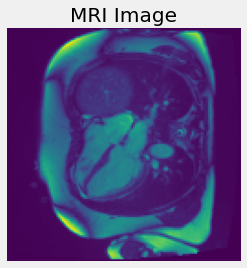

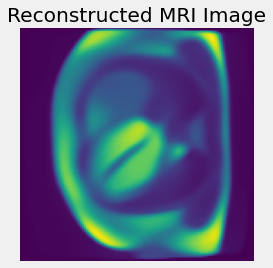


-------------------    Plot of MRI/Reconstructed MRI:   51    -------------------



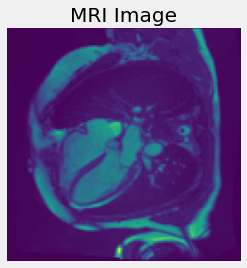

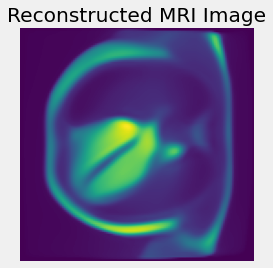


-------------------    Plot of MRI/Reconstructed MRI:   52    -------------------



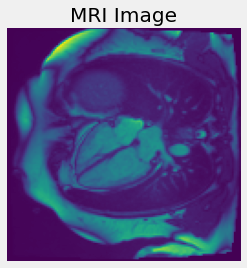

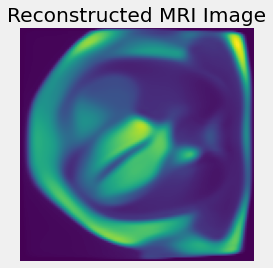


-------------------    Plot of MRI/Reconstructed MRI:   53    -------------------



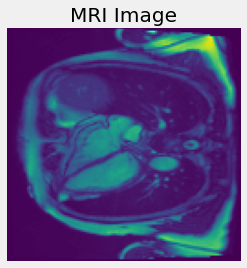

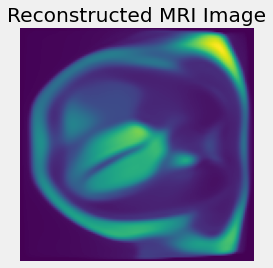


-------------------    Plot of MRI/Reconstructed MRI:   54    -------------------



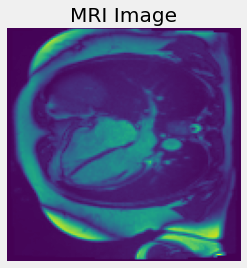

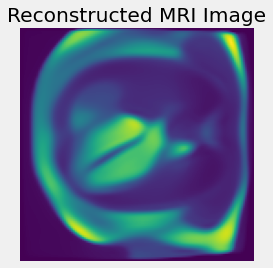


-------------------    Plot of MRI/Reconstructed MRI:   55    -------------------



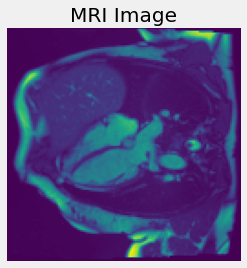

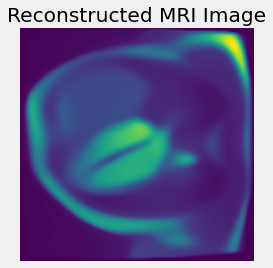


-------------------    Plot of MRI/Reconstructed MRI:   56    -------------------



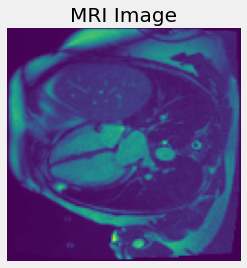

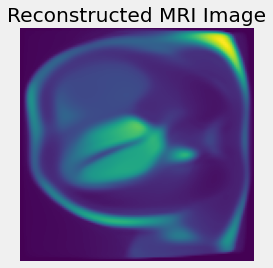


-------------------    Plot of MRI/Reconstructed MRI:   57    -------------------



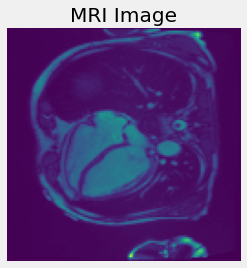

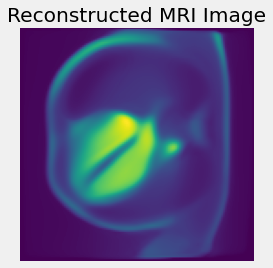


-------------------    Plot of MRI/Reconstructed MRI:   58    -------------------



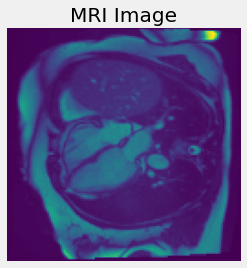

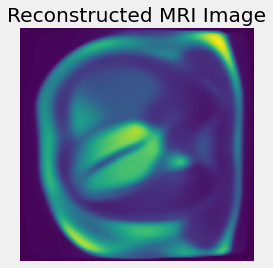


-------------------    Plot of MRI/Reconstructed MRI:   59    -------------------



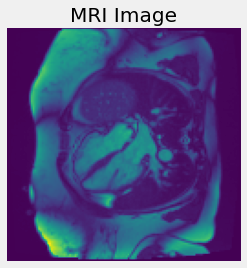

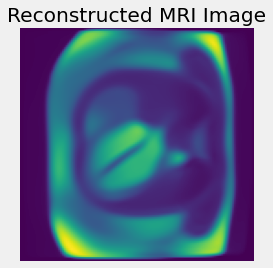


-------------------    Plot of MRI/Reconstructed MRI:   60    -------------------



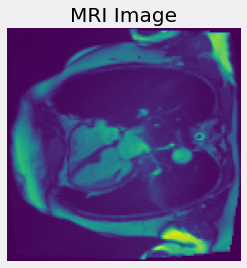

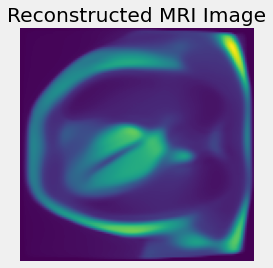


-------------------    Plot of MRI/Reconstructed MRI:   61    -------------------



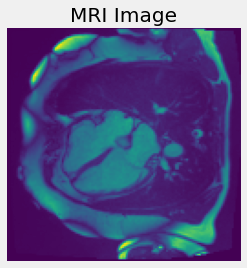

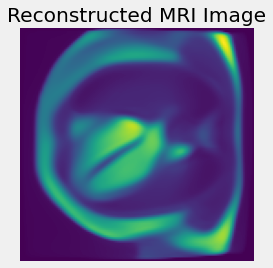


-------------------    Plot of MRI/Reconstructed MRI:   62    -------------------



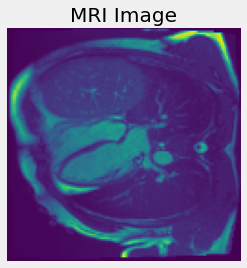

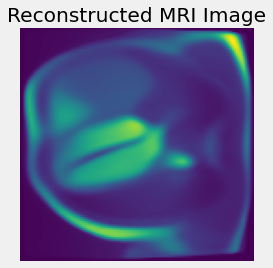


-------------------    Plot of MRI/Reconstructed MRI:   63    -------------------



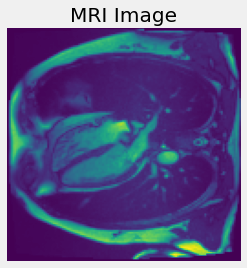

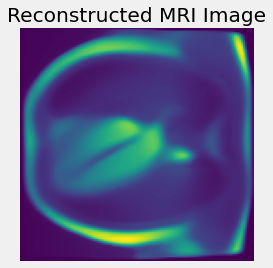

In [62]:
for output in outputs[:1]:
    _, ecg_signal, mri_image, _, reconstructed_mri = output
    
    for i in range(len(ecg_signal)):
        
        print("")
        print("-------------------    Plot of MRI/Reconstructed MRI:  ", i,"   -------------------\n")
        
        plt.figure()
        mri = mri_image[i].reshape(128, 128)
        plt.imshow(mri.cpu().detach().numpy())
        plt.title('MRI Image')
        plt.axis('off')
        
        plt.figure()
        rec_mri = reconstructed_mri[i].reshape(128, 128)
        plt.imshow(rec_mri.cpu().detach().numpy())
        plt.title('Reconstructed MRI Image')
        plt.axis('off') 
        
        plt.show()

Epoch: 30


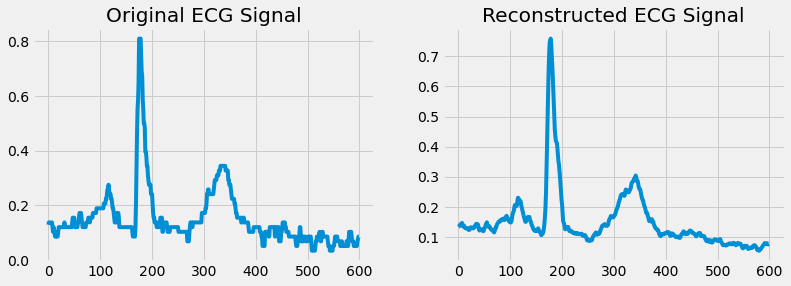

Epoch: 30


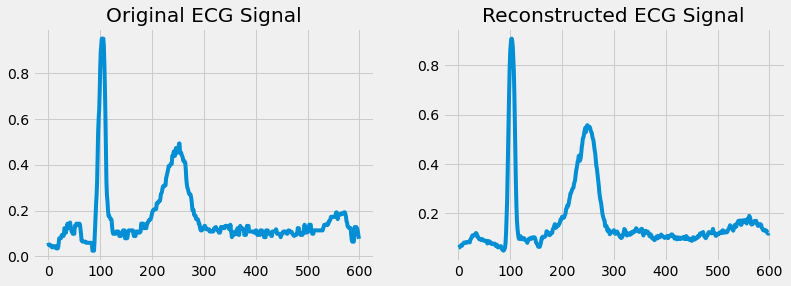

In [63]:
for item in outputs[:2]:
    epoch, ecg_signal, _, reconstructed_ecg, _ = item
    print(f"Epoch: {epoch}")
    
     # Plot the ECG signal and reconstructed ECG signal side by side
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 4))
    ax1.plot(ecg_signal[0].detach().cpu().numpy())
    ax1.set_title('Original ECG Signal')
    ax2.plot(reconstructed_ecg[0].detach().cpu().numpy())
    ax2.set_title('Reconstructed ECG Signal')
    plt.show()

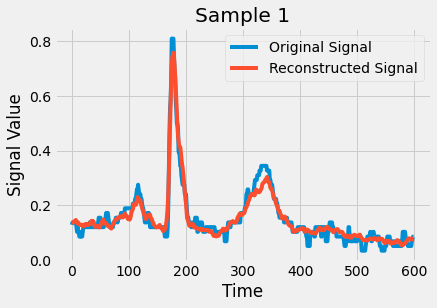

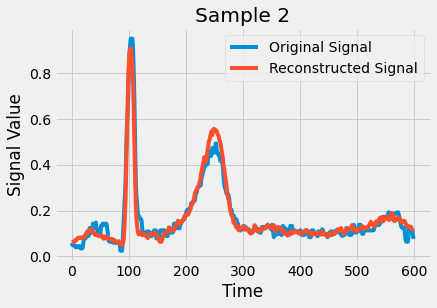

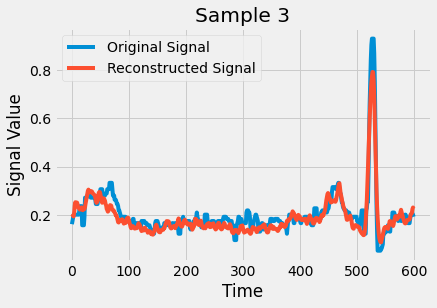

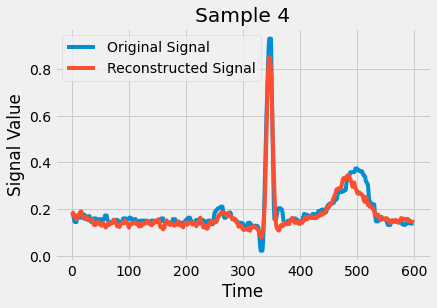

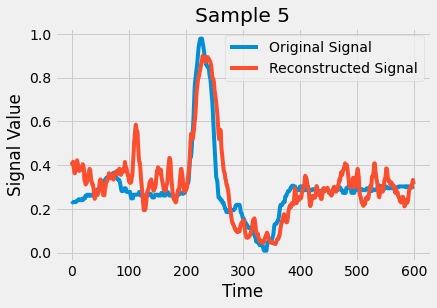

...

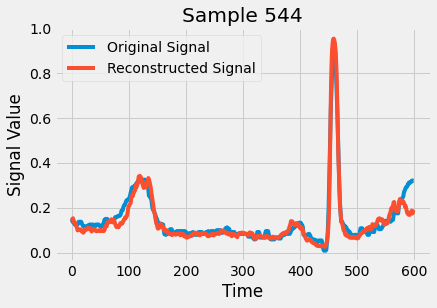

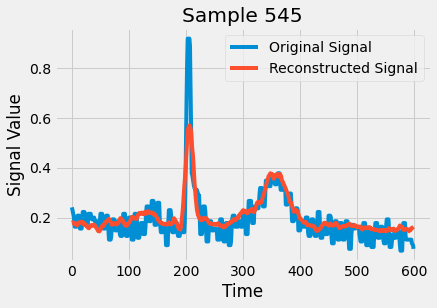

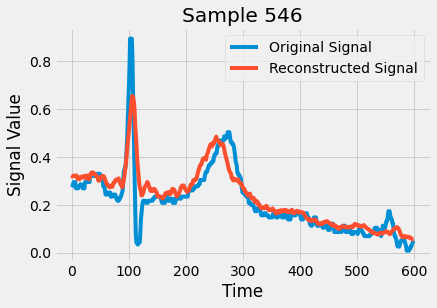

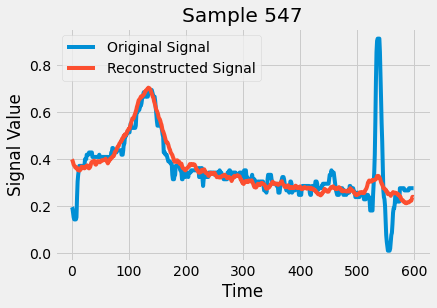

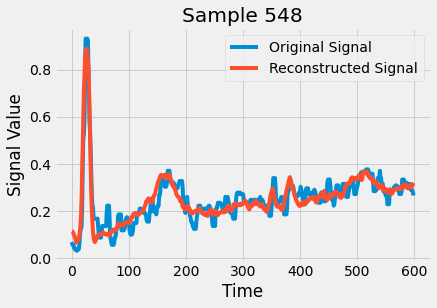

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [64]:
# Plotting the original and reconstructed signals
for i, output in enumerate(outputs):
    original_signal = output[1]
    reconstructed_signal = output[3]

    original_signal_np = original_signal[0].cpu().detach().numpy()
    reconstructed_signal_np = reconstructed_signal[0].cpu().detach().numpy()

    # Create a time axis for plotting (assuming the signals are sampled evenly)
    time = range(len(original_signal_np))

    # Plot the original and reconstructed signals
    plt.figure()
    plt.plot(time, original_signal_np, label='Original Signal')
    plt.plot(time, reconstructed_signal_np, label='Reconstructed Signal')
    plt.xlabel('Time')
    plt.ylabel('Signal Value')
    plt.title(f'Sample {i+1}')
    plt.legend()
    plt.show()

In [ ]:
del encoded_ecgs, encoded_mris, losses, ecg_losses, mri_losses
torch.cuda.empty_cache()

In [ ]:
del outputs
torch.cuda.empty_cache()

## Validation

During the validation loop, we are not updating the model's parameters. Early stopping technique. Thats why the validation loop has less epochs than the training loop. Evaluate the performance of the model during training.

In [65]:
device = "cpu"

In [66]:
model = model.to(device)

In [67]:
epochs = 1
outputs = []
val_ecg_losses = []
val_mri_losses = []
val_losses = []

val_encoded_ecgs = []
val_encoded_mris = []

##################################################################################################################
###########################                 VALIDATION                ############################################
##################################################################################################################

print("Starting the Validation Loop...","\n")
print("-------    Validation    -------","\n")

model.eval()

for epoch in range(epochs):
   
    print("")
    print(f"Epoch {epoch+1}\n-------------------------------")
    
    for i, (ecg_signal, mri_image) in enumerate(val_loader):
        
        if (mri_image.shape[0] == batch_size):
        
            # Send the training data to the GPU
            #ecg_signal, mri_image = ecg_signal.to(device) , mri_image.to(device)

            # Output of CustomModel (Dont have to pass the reconstructed items to the GPU)
            encoded_ecg, encoded_mri, reconstructed_ecg, reconstructed_mri = model(ecg_signal, mri_image)

            # Calculating the loss function
            val_loss_ecg = loss_function(reconstructed_ecg, ecg_signal)
            val_loss_mri = loss_function(reconstructed_mri, mri_image)
            val_loss = compute_loss(reconstructed_ecg, reconstructed_mri, ecg_signal, mri_image, encoded_ecg, encoded_mri, lamda_rec=1, lamda=0.1, temperature=0.5)


            # Storing the losses in a list for plotting
            print("Validation Loss: ", val_loss.item())
            #print("Validation ECG Loss: ", val_loss_ecg.item(),"Validation MRI Loss: ", val_loss_mri.item())
            val_ecg_losses.append(val_loss_ecg.item())
            val_mri_losses.append(val_loss_mri.item())
            val_losses.append(val_loss.item())
            outputs.append((epochs, ecg_signal, mri_image, reconstructed_ecg, reconstructed_mri))
            
            # Save encoded ECG's and MRI's for the latent space visualisation
            if (epoch == epochs - 1):
                val_encoded_ecgs.append(encoded_ecg)
                val_encoded_mris.append(encoded_mri)
            
            # Delete the tensors to free up GPU memory
            #del ecg_signal, encoded_ecg, encoded_mri, reconstructed_ecg, mri_image, reconstructed_mri#, val_loss_ecg, val_loss_mri, val_loss

            # Empty the GPU cache to release memory
            #torch.cuda.empty_cache()
        
    #break
    
    print("")
    
print("")
print("Done!")

Starting the Validation Loop... 

-------    Validation    ------- 


Epoch 1
-------------------------------
Validation Loss:  3.2516393661499023
Validation Loss:  3.5229737758636475
Validation Loss:  3.4396109580993652
Validation Loss:  3.537609815597534
Validation Loss:  3.4443554878234863
Validation Loss:  3.4401261806488037
Validation Loss:  3.3681981563568115
Validation Loss:  3.435343027114868
Validation Loss:  3.428281545639038
Validation Loss:  3.3774173259735107
Validation Loss:  3.6691126823425293
Validation Loss:  3.4434142112731934
Validation Loss:  3.4692726135253906


Done!


### Plot T-SNE for Validation

In [ ]:
val_ecg_results = []
val_mri_results = []

for ecg, mri in zip(val_encoded_ecgs, val_encoded_mris):
    mri = mri.squeeze().squeeze()

    # Convert the lists of tensors into NumPy arrays
    ecg = np.array(ecg.cpu().detach().numpy())
    mri = np.array(mri.cpu().detach().numpy())

    combined_features = np.concatenate((ecg, mri), axis=0)

    # Perform t-SNE on the combined features
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(combined_features)

    # Separate the t-SNE results for ecgs and mris
    ecg_tsne = tsne_results[:len(ecg)]
    mri_tsne = tsne_results[len(ecg):]

    val_ecg_results.append(ecg_tsne)
    val_mri_results.append(mri_tsne)

# Concatenate the results
val_ecg_results = np.concatenate(val_ecg_results, axis=0)
val_mri_results = np.concatenate(val_mri_results, axis=0)

# Plot the t-SNE results
plt.figure(figsize=(10, 5))
plt.scatter(val_ecg_results[:, 0], val_ecg_results[:, 1], color='red', label='ECG', s=2)
plt.scatter(val_mri_results[:, 0], val_mri_results[:, 1], color='blue', label='MRI', s=2)
plt.title('t-SNE Plot of ECG and MRI Features in Latent Space for Validation')
plt.xlim(-30, 30)
plt.ylim(-30, 30)
plt.legend()
plt.show()

### Total Loss

In [ ]:
# Defining the Plot Style
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Validation Total Loss')

# Plotting values
plt.plot(val_losses[-10000:])
plt.show()

### ECG Loss

In [ ]:
# Defining the Plot Style
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Validation ECG Loss')

# Plotting values
plt.plot(val_ecg_losses[-10000:])
plt.show()

### MRI Loss

In [ ]:
# Defining the Plot Style
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Validation MRI Loss')

# Plotting values
plt.plot(val_mri_losses[-10000:])
plt.show()

### Plotting the Original and Reconstructed Image


-------------------    Plot of MRI/Reconstructed MRI:   0    -------------------



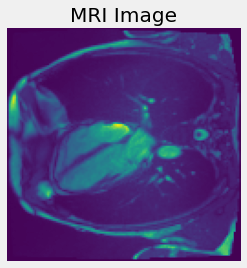

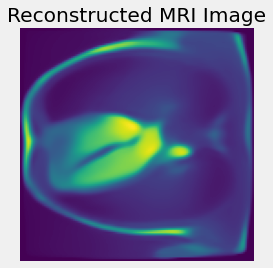


-------------------    Plot of MRI/Reconstructed MRI:   1    -------------------



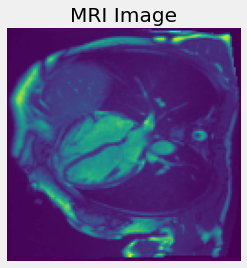

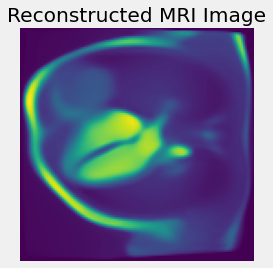


-------------------    Plot of MRI/Reconstructed MRI:   2    -------------------



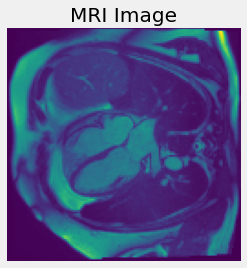

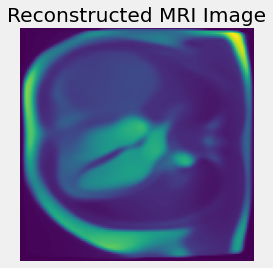


-------------------    Plot of MRI/Reconstructed MRI:   3    -------------------



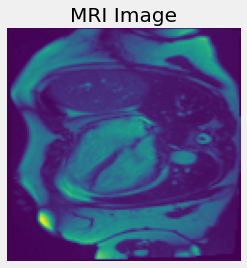

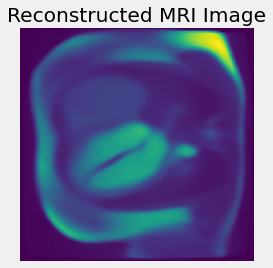


-------------------    Plot of MRI/Reconstructed MRI:   4    -------------------



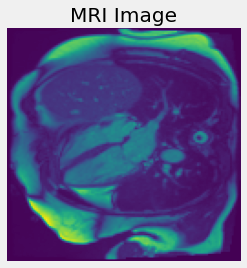

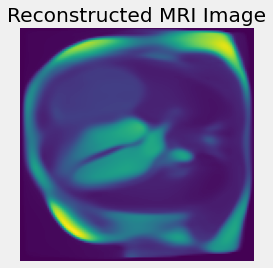


-------------------    Plot of MRI/Reconstructed MRI:   5    -------------------



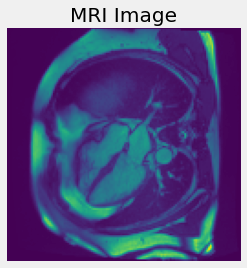

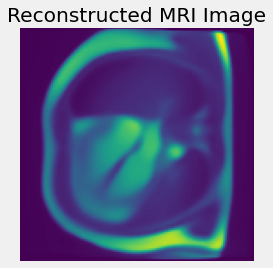


-------------------    Plot of MRI/Reconstructed MRI:   6    -------------------



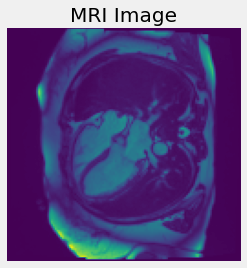

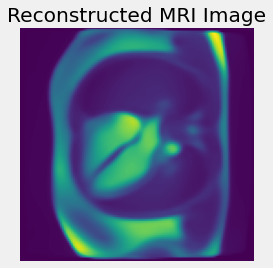


-------------------    Plot of MRI/Reconstructed MRI:   7    -------------------



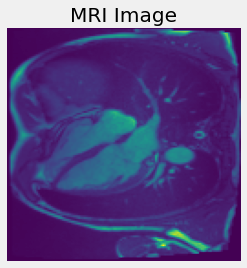

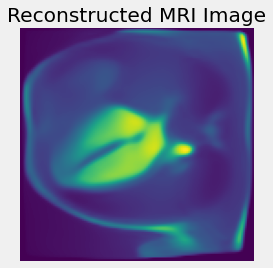


-------------------    Plot of MRI/Reconstructed MRI:   8    -------------------



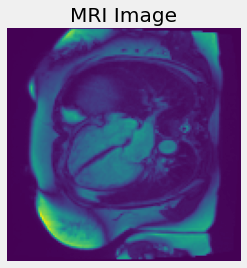

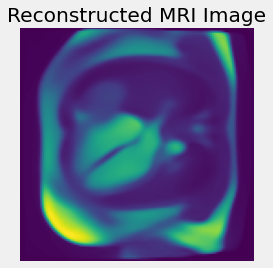


-------------------    Plot of MRI/Reconstructed MRI:   9    -------------------



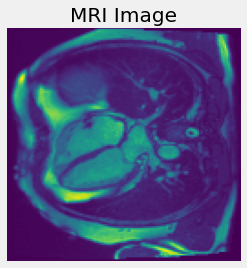

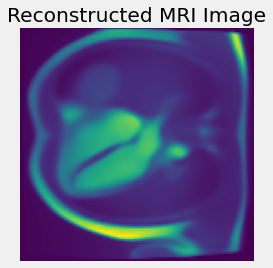


-------------------    Plot of MRI/Reconstructed MRI:   10    -------------------



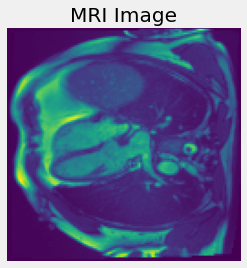

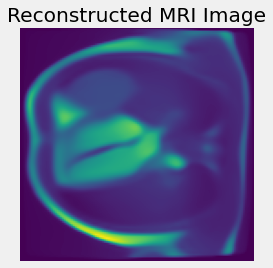


-------------------    Plot of MRI/Reconstructed MRI:   11    -------------------



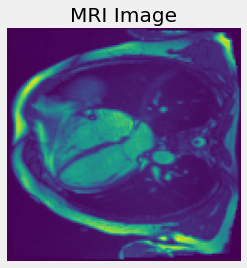

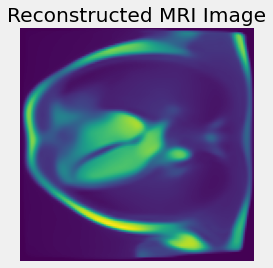


-------------------    Plot of MRI/Reconstructed MRI:   12    -------------------



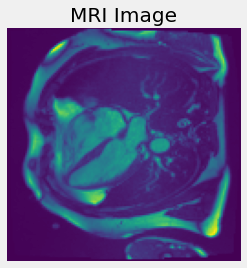

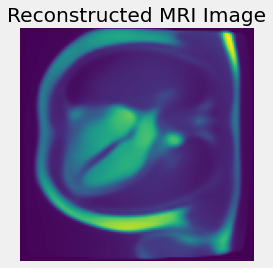


-------------------    Plot of MRI/Reconstructed MRI:   13    -------------------



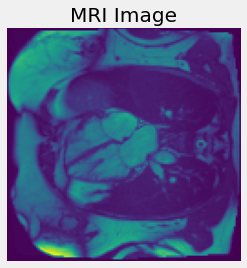

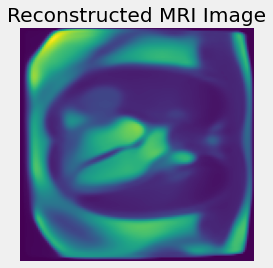


-------------------    Plot of MRI/Reconstructed MRI:   14    -------------------



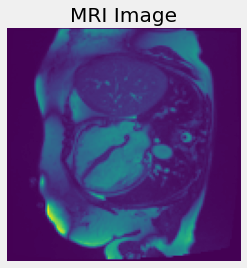

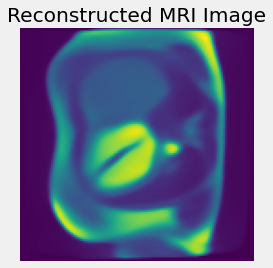


-------------------    Plot of MRI/Reconstructed MRI:   15    -------------------



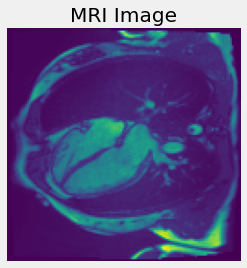

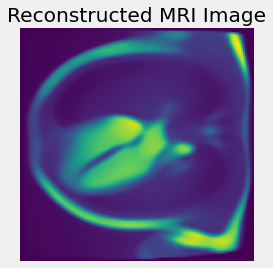


-------------------    Plot of MRI/Reconstructed MRI:   16    -------------------



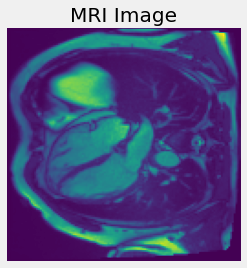

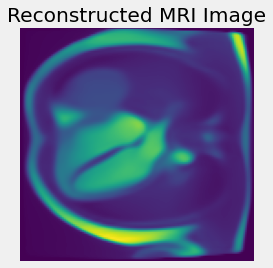


-------------------    Plot of MRI/Reconstructed MRI:   17    -------------------



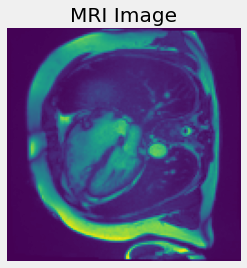

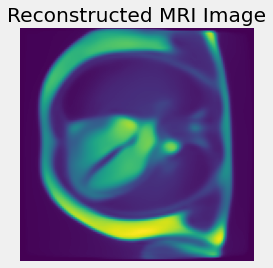


-------------------    Plot of MRI/Reconstructed MRI:   18    -------------------



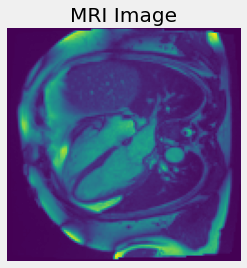

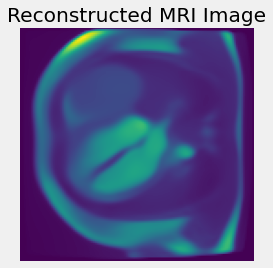


-------------------    Plot of MRI/Reconstructed MRI:   19    -------------------



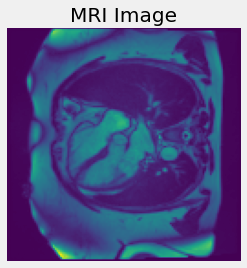

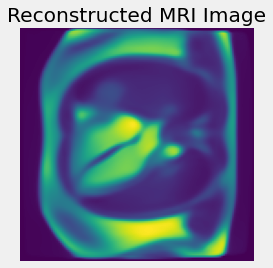


-------------------    Plot of MRI/Reconstructed MRI:   20    -------------------



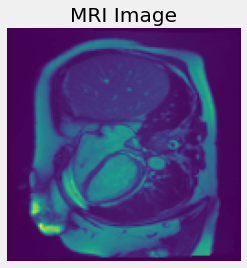

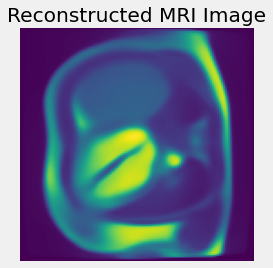


-------------------    Plot of MRI/Reconstructed MRI:   21    -------------------



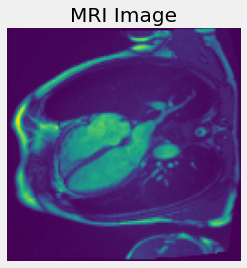

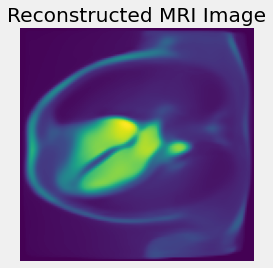


-------------------    Plot of MRI/Reconstructed MRI:   22    -------------------



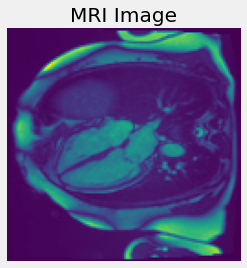

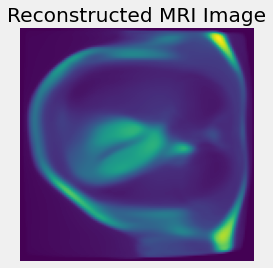


-------------------    Plot of MRI/Reconstructed MRI:   23    -------------------



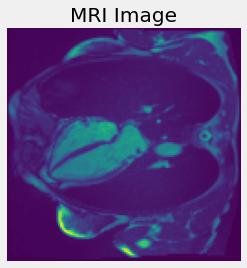

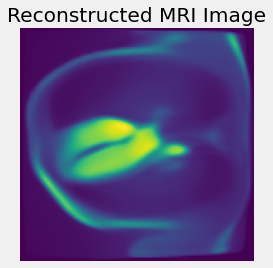


-------------------    Plot of MRI/Reconstructed MRI:   24    -------------------



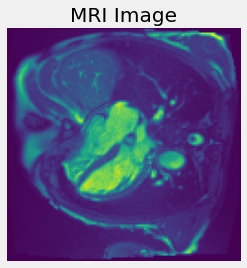

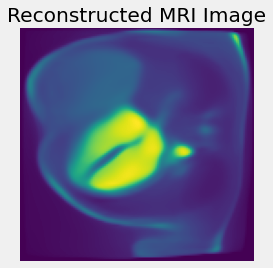


-------------------    Plot of MRI/Reconstructed MRI:   25    -------------------



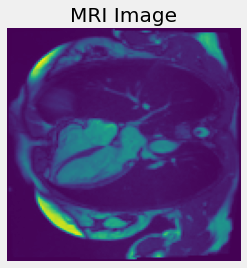

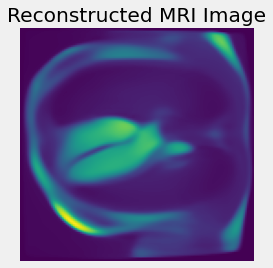


-------------------    Plot of MRI/Reconstructed MRI:   26    -------------------



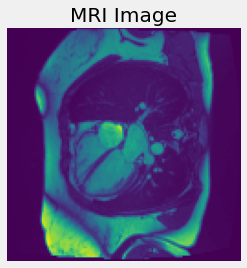

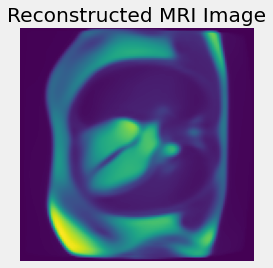


-------------------    Plot of MRI/Reconstructed MRI:   27    -------------------



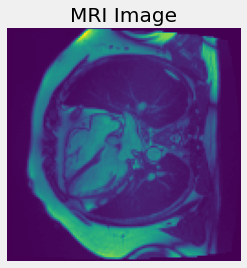

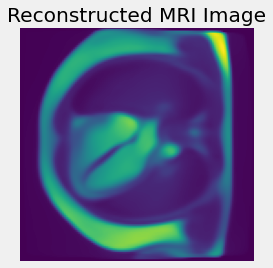


-------------------    Plot of MRI/Reconstructed MRI:   28    -------------------



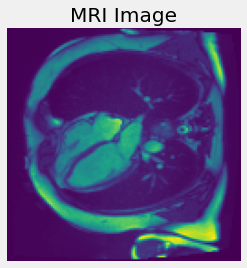

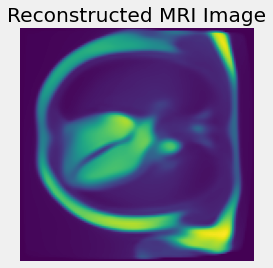


-------------------    Plot of MRI/Reconstructed MRI:   29    -------------------



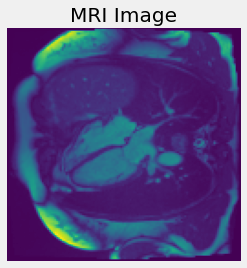

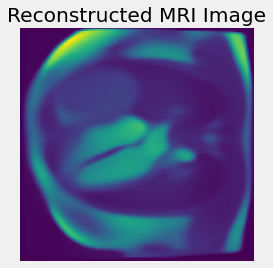

In [68]:
for output in outputs[:1]:
    _, _, mri_image, _, reconstructed_mri = output
    
    for i in range(len(ecg_signal)):
        
        print("")
        print("-------------------    Plot of MRI/Reconstructed MRI:  ", i,"   -------------------\n")
        
        plt.figure()
        mri = mri_image[i].reshape(128, 128)
        plt.imshow(mri.cpu().detach().numpy())
        plt.title('MRI Image')
        plt.axis('off')
        
        plt.figure()
        rec_mri = reconstructed_mri[i].reshape(128, 128)
        plt.imshow(rec_mri.cpu().detach().numpy())
        plt.title('Reconstructed MRI Image')
        plt.axis('off') 
        
        plt.show()

## *** Save the ECG_MRI_autoencoder model parameters ***

In [69]:
# # Define the file path
# file_path = 'models/ecg_mri_model_weights.pth'

# # Check if the file exists
# if os.path.exists(file_path):
#     # Delete the file
#     os.remove(file_path)

In [70]:
# torch.save(model.state_dict(), file_path)

### Free CUDA Memory

In [ ]:
# model.cpu()
# del model
# gc.collect()
# torch.cuda.empty_cache()

In [ ]:
#print_gpu_utilization()

## <center><u>Results</u></center>

- Batch size = 64 and N = 10 epochs

<div>
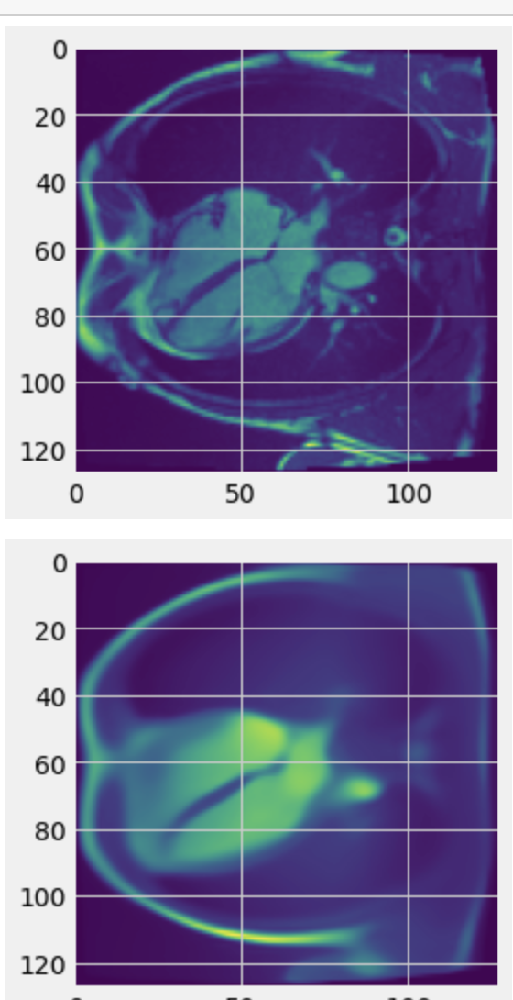
</div>

<div>
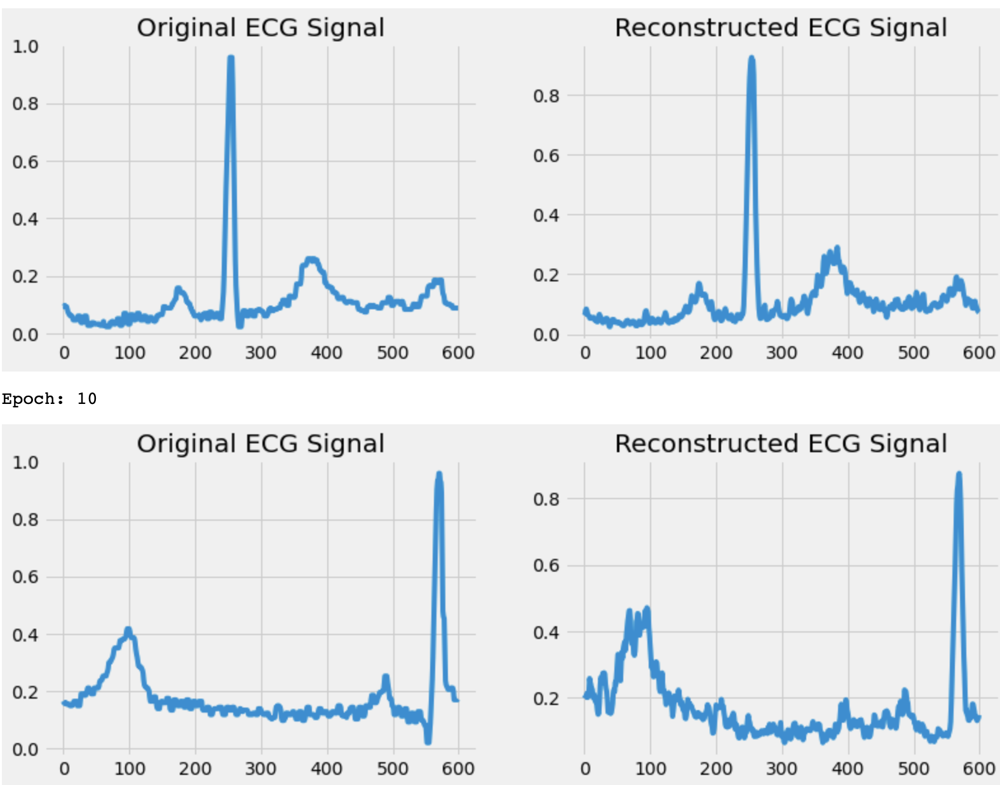
</div>

<div>
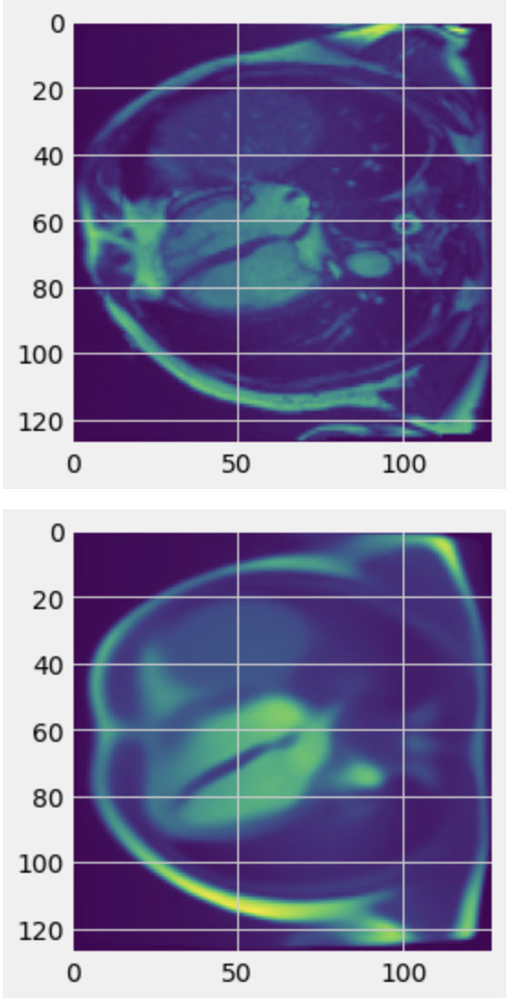
</div>

- Batch size 32 and N = 10 epochs

<div>
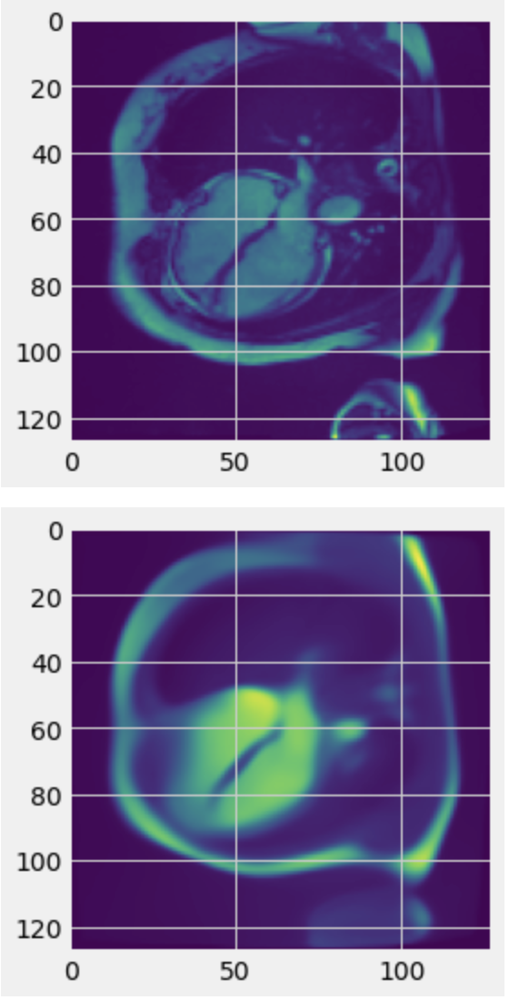
</div>

<div>
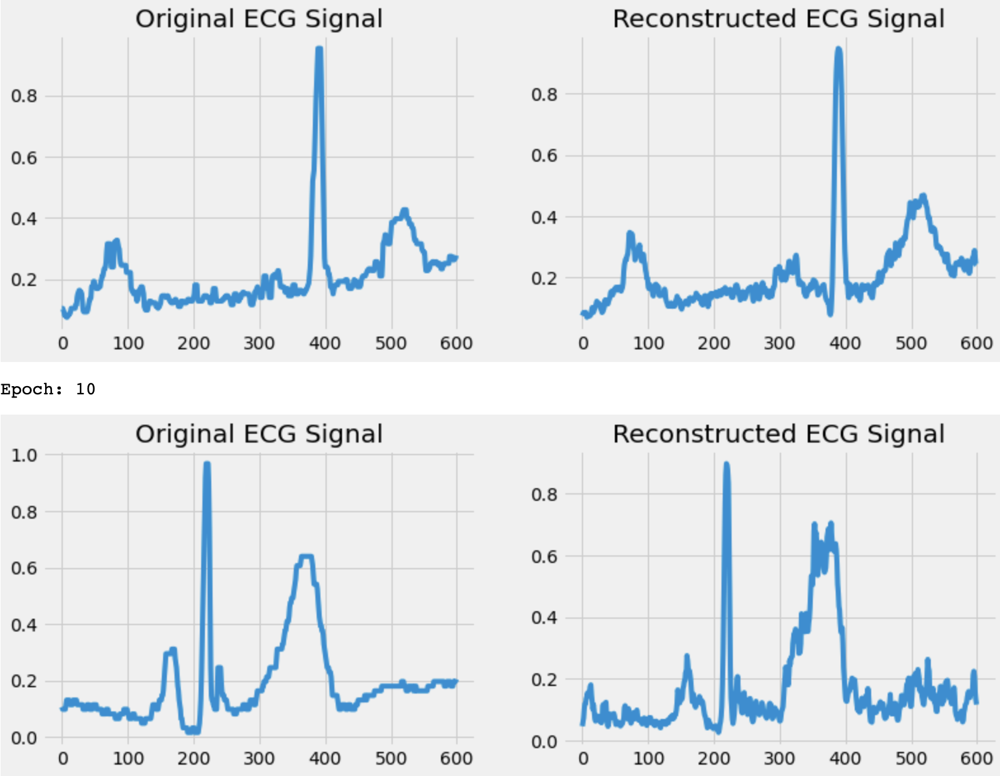
</div>

<div>
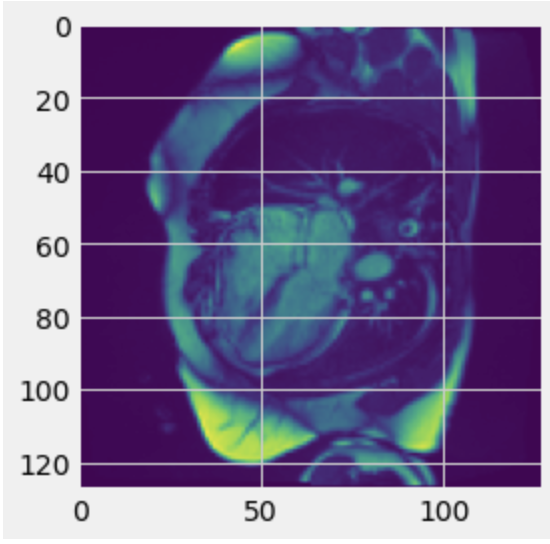
</div>

<div>
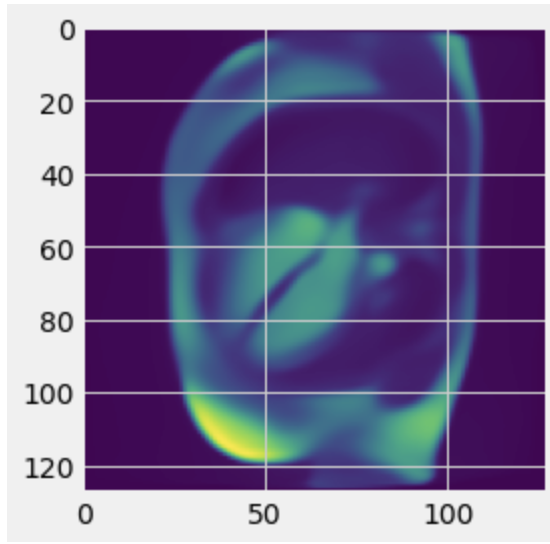
</div>

<div>
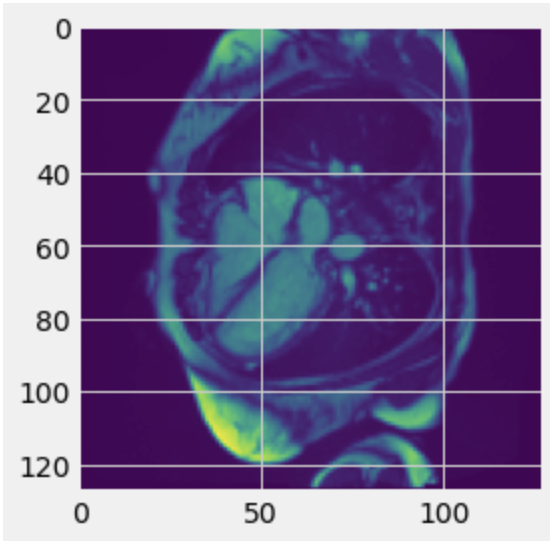
</div>

<div>
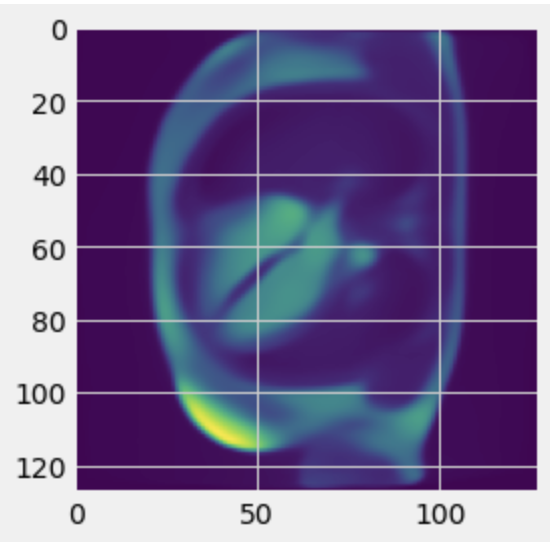
</div>

<div>
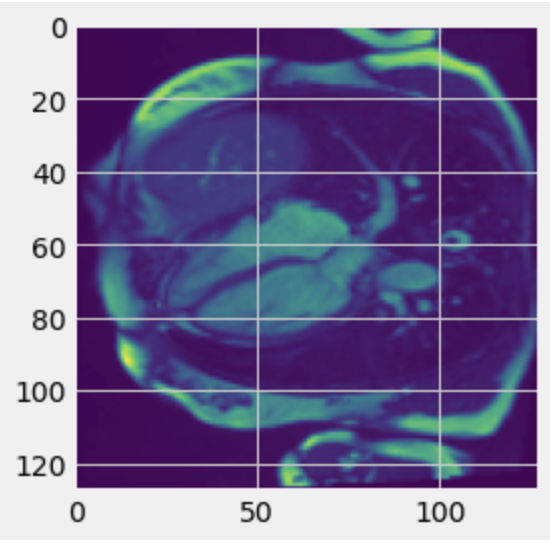
</div>

<div>
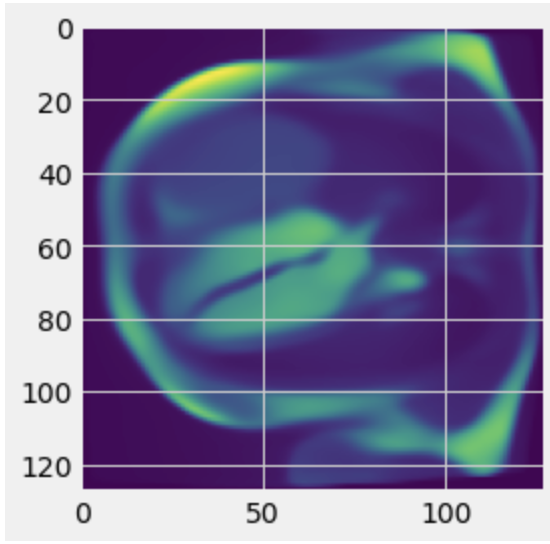
</div>

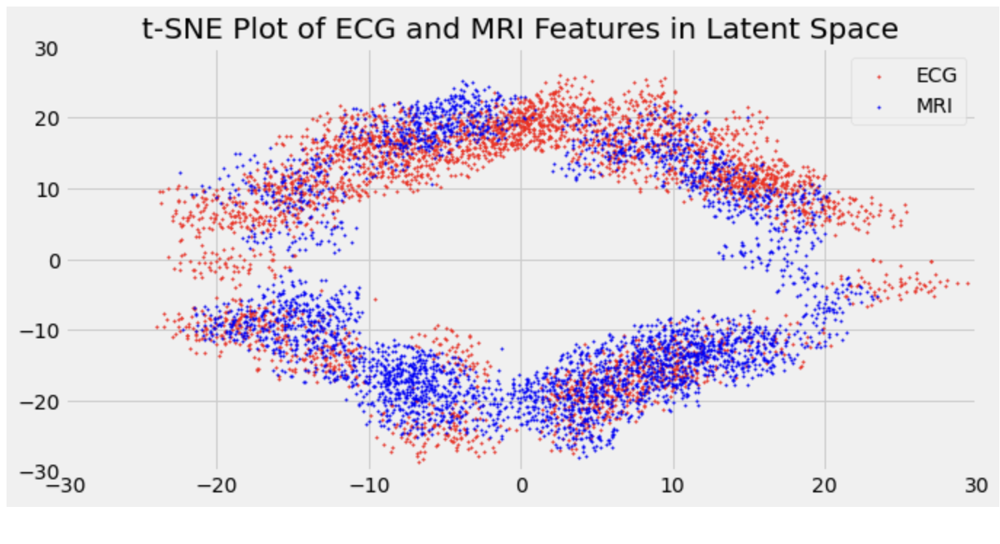

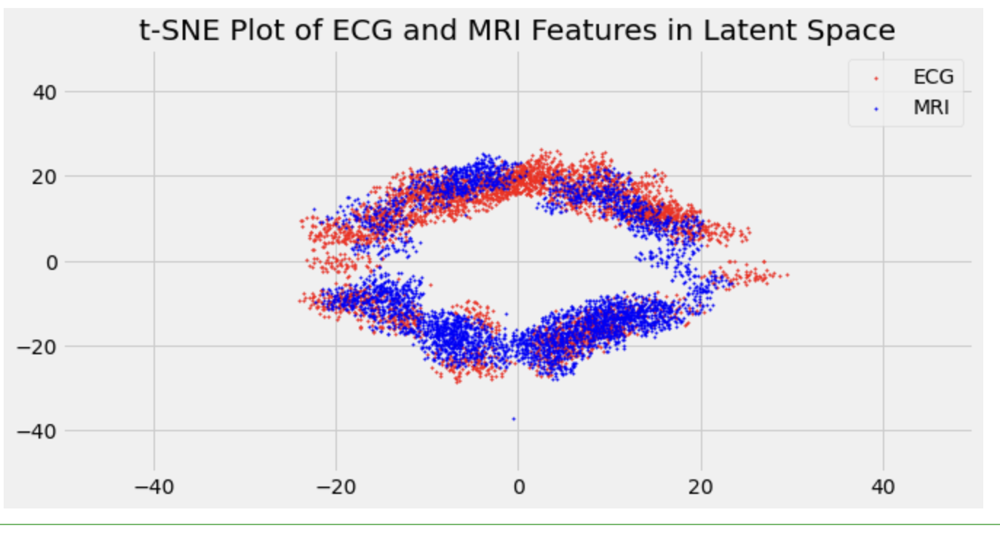